In [1]:
import subprocess
import os
import shutil
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm 
from matplotlib.colors import Normalize
from matplotlib.ticker import MaxNLocator
import glob
import re
#import holoviews as hv
import MDAnalysis as mda
from MDAnalysis.analysis import distances, contacts, align, rms
from MDAnalysis.analysis.pca import PCA
import seaborn as sns
import math
from scipy.stats import ttest_ind, mannwhitneyu
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.patches as mpatches
import plotly

/home/fede/miniconda3/envs/env_md_analysis/lib/python3.10/site-packages/Bio/Application/__init__.py:39: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


# Processing

### File import

In [2]:
sourcedir= "/mnt/ssd1/storage/MD_trajectories/5LOX/wt_str"
workdir = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD"

In [3]:
init = 'step3_input'
mini_prefix = 'step4.0_minimization'
equi_prefix = 'step4.1_equilibration'
prod_prefix = 'step5_production'

In [ ]:
source_prefixes = ["wt_str_ca2_atp_out/r1", "wt_str_ca2_atp_out/r2", "wt_str_ca2_atp_out/r3", "wt_str_ca2/r1", "wt_str_ca2/r2", "wt_str_ca2/r3"]
dest_prefixes = source_prefixes  

for prefix in dest_prefixes:
    dest_path = os.path.join(workdir, prefix)
    os.makedirs(dest_path, exist_ok=True)
    print(f"Created destination folder: {dest_path}")

def copy_files(src_files, dest_folder):
    for file in src_files:
        try:
            shutil.copy2(file, dest_folder)  
            print(f"Copied {file} to {dest_folder}")
        except FileNotFoundError:
            print(f"Warning: {file} not found and could not be copied.")

for i, source_prefix in enumerate(source_prefixes):
    print(f"Processing source prefix: {source_prefix}")
    
    source_path = os.path.join(sourcedir, source_prefix)
    dest_path = os.path.join(workdir, dest_prefixes[i])
    
    # List of files to copy to  based on the given prefixes
    specific_files = [
        os.path.join(source_path, f"{prod_prefix}.xtc"),
        os.path.join(source_path, f"{prod_prefix}.gro"),
        os.path.join(source_path, f"{prod_prefix}.tpr")
    ]

    # Copy production-specific files to the corresponding destination folder
    copy_files(specific_files, dest_path)
    
    parent_dir = os.path.dirname(source_prefix)
    
    additional_files = [
        os.path.join(sourcedir, parent_dir, "index.ndx"),
        os.path.join(sourcedir, parent_dir, "job.sh"),
        os.path.join(sourcedir, parent_dir, f"{equi_prefix}.gro"),
        os.path.join(sourcedir, parent_dir, f"{equi_prefix}.tpr"),
        os.path.join(sourcedir, parent_dir, f"{init}.gro"),
        os.path.join(sourcedir, parent_dir, f"{init}.pdb")
    ]
    

    dest_parent_path = os.path.join(workdir, parent_dir)
    os.makedirs(dest_parent_path, exist_ok=True)

    # Copy the additional files to the parent directory
    copy_files(additional_files, dest_parent_path)


Created destination folder: /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r1
Created destination folder: /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r2
Created destination folder: /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r3
Created destination folder: /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r1
Created destination folder: /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r2
Created destination folder: /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r3
Processing source prefix: wt_str_ca2_atp_out/r1
Copied /mnt/ssd1/storage/MD_trajectories/5LOX/wt_str/wt_str_ca2_atp_out/r1/step5_production.xtc to /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r1
Copied /mnt/ssd1/storage/MD_trajectories/5LOX/wt_str/wt_str_ca2_atp_out/r1/step5_production.gro to /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r1
Copied /mnt/ssd1/storage/MD_trajec

### GMX processing

In [ ]:
    # ALL TRAJECTORIES
    dirs = ["wt_str_ca2", "wt_str_ca2_atp_out"]

    for dir in dirs:
        reps = ["r1", "r2", "r3"]

        mergedir = os.path.join(workdir, dir, 'merged')
        os.makedirs(mergedir, exist_ok=True)
        directory= os.path.join(workdir, dir)
        os.chdir(directory)
        ## protein-only structure for fast protein visualization
        subprocess.run(['gmx', 'editconf', '-f', f'{init}.gro', '-o', f'mdstr_{init}_prot.gro', '-ndef'], input='1\n', text=True)
        subprocess.run(['gmx', 'editconf', '-f', f'{init}.gro', '-o', f'mdstr_{init}_prot.pdb', '-ndef'], input='1\n', text=True)



        for rep in reps:
            repdir = os.path.join(workdir, dir, rep)
            os.chdir(repdir)
            
            # PROCESS TRAJECTORY TO PROTEIN
            subprocess.run(['gmx', 'trjconv', '-f', f'{prod_prefix}.xtc', '-s', f'../{equi_prefix}.tpr', '-o', f'mdtrj_{rep}_prot_cut.xtc', '-center', '-pbc', 'mol', '-dt', '1000'], input='1 1\n', text=True)
            subprocess.run(['gmx', 'trjconv', '-f', f'mdtrj_{rep}_prot_cut.xtc', '-s', f'../{equi_prefix}.tpr', '-o', f'mdtrj_{rep}_prot_fit.xtc', '-fit', 'rot+trans'], input='1 1\n', text=True)
            os.remove(f'mdtrj_{rep}_prot_cut.xtc')
            shutil.copy(f'mdtrj_{rep}_prot_fit.xtc', mergedir)
##
            #### PROCESS TRAJECTORY TO SYSTEM
            subprocess.run(['gmx', 'trjconv', '-f', f'{prod_prefix}.xtc', '-s', f'../{equi_prefix}.tpr', '-o', f'mdtrj_{rep}_syst_cut.xtc', '-center', '-pbc', 'mol', '-dt', '1000'], input='1 0\n', text=True)
            subprocess.run(['gmx', 'trjconv', '-f', f'mdtrj_{rep}_syst_cut.xtc', '-s', f'../{equi_prefix}.tpr', '-o', f'mdtrj_{rep}_syst_fit.xtc', '-fit', 'rot+trans'], input='1 0\n', text=True)
            os.remove(f'mdtrj_{rep}_syst_cut.xtc')
            shutil.copy(f'mdtrj_{rep}_syst_fit.xtc', mergedir)
            #
            os.remove(f'{prod_prefix}.xtc')

            # RMSD RMSF 
            #subprocess.run(['gmx', 'rms', '-s', f'../{init}.gro', '-f', f'mdtrj_{rep}_prot_fit.xtc', '-o', f'rmsd_{rep}_init_bb.xvg', '-tu', 'ns'], input='4 4\n', text=True)
            #subprocess.run(['gmx', 'rms', '-s', f'../{init}.gro', '-f', f'mdtrj_{rep}_prot_fit.xtc', '-o', f'rmsd_{rep}_init_ca.xvg', '-tu', 'ns'], input='3 3\n', text=True)
            #subprocess.run(['gmx', 'rmsf', '-s', f'../{init}.gro', '-f', f'mdtrj_{rep}_prot_fit.xtc', '-o', f'rmsf_{rep}_init_ca.xvg', '-res'], input='3\n', text=True)


        os.chdir(mergedir)

        # Merge (could improve by setting consecutive starting times)
        subprocess.run(['gmx', 'trjcat', '-f', f'mdtrj_{reps[0]}_prot_fit.xtc', f'mdtrj_{reps[1]}_prot_fit.xtc', f'mdtrj_{reps[2]}_prot_fit.xtc', '-o', 'mdtrj_merged_prot_fit.xtc', '-cat'], text=True)
        os.remove(f'mdtrj_{reps[0]}_prot_fit.xtc')
        os.remove(f'mdtrj_{reps[1]}_prot_fit.xtc')
        os.remove(f'mdtrj_{reps[2]}_prot_fit.xtc')

        # MERGED IRON + PROTEIN FOR CAVITY DETECTION
        #subprocess.run(['gmx', 'trjcat', '-f', f'mdtrj_{reps[0]}_syst_fit.xtc', f'mdtrj_{reps[1]}_syst_fit.xtc', f'mdtrj_{reps[2]}_syst_fit.xtc', '-o', 'mdtrj_merged_prot_FE2P_fit.xtc', '-cat', '-n', '../index.ndx'], text=True)
        #os.remove(f'mdtrj_{reps[0]}_syst_fit.xtc')
        #os.remove(f'mdtrj_{reps[1]}_syst_fit.xtc')
        #os.remove(f'mdtrj_{reps[2]}_syst_fit.xtc')

    

               :-) GROMACS - gmx editconf, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2
Command line:
  gmx editconf -f step3_input.gro -o mdstr_step3_input_prot.gro -ndef


Select a group for output:
Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159262 elements
Group    12 (          O

Note that major changes are planned in future for editconf, to improve usability and utility.
Read 170159 atoms
Volume: 1815.85 nm^3, corresponds to roughly 817100 electrons
No velocities found
Selected 1: 'Protein'
Note that major changes are planned in future for editconf, to improve usability and utility.
Read 170159 atoms
Volume: 1815.85 nm^3, corresponds to roughly 817100 electrons
No velocities found
Selected 1: 'Protein'


Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159262 elements
Group    12 (          Other) has 159262 elements
Group    13 (           FE2P) has     1 elements
Group    14 (            POT) has   167 elements
Group    15 (            CAL) has     6 elements
Group    16 (            CLA) has   163 elements
Group    17 (           TIP3) has 158925 elements
Select a group: 
GROMACS reminds you: "Rub It Right Across Your Eyes" (F. Zappa)

               :-) GROMACS - gmx

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "I Ripped the Cord Right Out Of the Phone" (Capt. Beefheart)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r1
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r1_syst_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame       3000 time 300000.000    ->  frame    200 time 200000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "In a talk you have a choice: You can make one point or no points." (Paul Sigler)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r1
Command line:
  gmx trjconv -f mdtrj_r1_syst_cut.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r1_syst_fit.xtc -fit rot+trans

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 108

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Can someone please tell Icarus that he's not the only one falling from the sky?" (Urban Dance Squad)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r2
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r2_prot_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)


Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159262 elements
Group    12 (          Other) has 159262 elements
Group    13 (           FE2P) has     1 elements
Group    14 (            POT) has   167 elements
Group    15 (            CAL) has     6 elements
Group    16 (            CLA) has   163 elements
Group    17 (           TIP3) has 158925 elements
Select a group: Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "The loveliest theories are being overthrown by these damned experiments; it is no fun being a chemist any more." (Justus von Liebig, letter to J.J. Berzelius 1834)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r2
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r2_syst_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single preci

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame       3000 time 300000.000    ->  frame    200 time 200000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Stay Cool, This is a Robbery" (Pulp Fiction)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r2
Command line:
  gmx trjconv -f mdtrj_r2_syst_cut.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r2_syst_fit.xtc -fit rot+trans

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Prote

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "If mathematical analysis should ever hold a prominent place in chemistry - an aberration which is happily almost impossible - it would occasion a rapid and widespread degeneration of that science." (Aguste Comte, 1830)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r3
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r3_prot_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equi

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159262 elements
Group    12 (          Other) has 159262 elements
Group    13 (           FE2P) has     1 elements
Group    14 (            POT) has   167 elements
Group    15 (            CAL) has     6 elements
Group    16 (            CLA) has   163 elements
Group    17 (           TIP3) has 158925 elements
Select a group: Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Statistics: The only science that enables different experts using the same figures to draw different conclusions." (Evan Esar)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r3
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r3_syst_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) h

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame       3000 time 300000.000    ->  frame    200 time 200000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Sitting on a rooftop watching molecules collide" (A Camp)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/r3
Command line:
  gmx trjconv -f mdtrj_r3_syst_cut.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r3_syst_fit.xtc -fit rot+trans

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170159 elements
Group     1 (        Protein) has 10897 elements
Group     2

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "gmx fellowship-writing -g grant_name -s protein_structure_involved -o output -m method_used -p list_of_pi" (Tanadet Pipatpolkai, while discussing new features for GROMACS)

                :-) GROMACS - gmx trjcat, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2/merged
Command line:
  gmx trjcat -f mdtrj_r1_prot_fit.xtc mdtrj_r2_prot_fit.xtc mdtrj_r3_prot_fit.xtc -o mdtrj_merged_prot_fit.xtc -cat

Reading frame       1 time 1000.000   

Summary of files and start times used:

          File                Start time       Time step
---------------------------------------------------------
    mdtrj_r1_prot_fit.xtc        0.

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    300 time 300000.000 ps     
Reading frame       0 time    0.000   
Continue writing frames from mdtrj_r2_prot_fit.xtc t=0 ps, frame=301      
Last frame        300 time 300000.000    ->  frame    601 time 300000.000 ps     
Reading frame       0 time    0.000   
Continue writing frames from mdtrj_r3_prot_fit.xtc t=0 ps, frame=602      
Last frame        300 time 300000.000    ->  frame    902 time 300000.000 ps     

Last frame written was 902, time 300000.000000 ps

GROMACS reminds you: "Unlike teachers or doctors, our efforts improve the lives of people we'll never meet." (Katie Busch-Sorensen)

               :-) GROMACS - gmx editconf, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out
Command line:
  gmx editconf -f step3_input.gro -o mdstr_ste

Note that major changes are planned in future for trjcat, to improve usability and utility.
lasttime 0

lasttime 300000

lasttime 300000
Note that major changes are planned in future for editconf, to improve usability and utility.
Read 170053 atoms
Volume: 1815.85 nm^3, corresponds to roughly 817100 electrons
No velocities found
Selected 1: 'Protein'



Select a group for output:
Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159156 elements
Group    12 (          Other) has 159156 elements
Group    13 (            ATP) has    43 elements
Group    14 (           FE2P) has     1 elements
Group    15 (            POT) has   171 elements
Group    16 (            CAL) has     6 elements
Group    17 (            CLA) has   163 elements
Group    18 (           TIP3) has 158772 elements
Select a group: 
GROMACS reminds you:

Note that major changes are planned in future for editconf, to improve usability and utility.
Read 170053 atoms
Volume: 1815.85 nm^3, corresponds to roughly 817100 electrons
No velocities found
Selected 1: 'Protein'


Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159156 elements
Group    12 (          Other) has 159156 elements
Group    13 (            ATP) has    43 elements
Group    14 (           FE2P) has     1 elements
Group    15 (            POT) has   171 elements
Group    16 (            CAL) has     6 elements
Group    17 (            CLA) has   163 elements
Group    18 (           TIP3) has 158772 elements
Select a group: Group     0 (         System) has 170053 elements

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "With four parameters I can fit an elephant, and with five I can make him wiggle his trunk." (John von Neumann)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r1
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r1_syst_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 17005

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame       3000 time 300000.000    ->  frame    200 time 200000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "The Microsecond is Within Reach" (P.J. Van Maaren)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r1
Command line:
  gmx trjconv -f mdtrj_r1_syst_cut.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r1_syst_fit.xtc -fit rot+trans

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
Group     

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "I tend to consider myself as a scientist." (Emmanuelle Charpentier, when asked about the importance of two women sharing the Nobel Prize for Chemistry)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r2
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r2_prot_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159156 elements
Group    12 (          Other) has 159156 elements
Group    13 (            ATP) has    43 elements
Group    14 (           FE2P) has     1 elements
Group    15 (            POT) has   171 elements
Group    16 (            CAL) has     6 elements
Group    17 (            CLA) has   163 elements
Group    18 (           TIP3) has 158772 elements
Select a group: Group     0 (         System) has 170053 elements

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "It's Because Of the Metric System" (Pulp Fiction)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r2
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r2_syst_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
G

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame       3000 time 300000.000    ->  frame    200 time 200000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Trying is the first step towards failure." (Homer Simpson)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r2
Command line:
  gmx trjconv -f mdtrj_r2_syst_cut.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r2_syst_fit.xtc -fit rot+trans

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
Gr

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "We can make it into a friend class. But I don't like having friends." (Joe Jordan)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r3
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r3_prot_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)


Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
Group     2 (      Protein-H) has  5501 elements
Group     3 (        C-alpha) has   674 elements
Group     4 (       Backbone) has  2022 elements
Group     5 (      MainChain) has  2695 elements
Group     6 (   MainChain+Cb) has  3336 elements
Group     7 (    MainChain+H) has  3334 elements
Group     8 (      SideChain) has  7563 elements
Group     9 (    SideChain-H) has  2806 elements
Group    10 (    Prot-Masses) has 10897 elements
Group    11 (    non-Protein) has 159156 elements
Group    12 (          Other) has 159156 elements
Group    13 (            ATP) has    43 elements
Group    14 (           FE2P) has     1 elements
Group    15 (            POT) has   171 elements
Group    16 (            CAL) has     6 elements
Group    17 (            CLA) has   163 elements
Group    18 (           TIP3) has 158772 elements
Select a group: Group     0 (         System) has 170053 elements

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Requiem, bring the dissident from slumber" (Bad Religion)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r3
Command line:
  gmx trjconv -f step5_production.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r3_syst_cut.xtc -center -pbc mol -dt 1000

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 el

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 1: 'Protein'


Last frame       3000 time 300000.000    ->  frame    200 time 200000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Nothing is more anarchic than power." (Pier Paolo Pasolini)

               :-) GROMACS - gmx trjconv, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/r3
Command line:
  gmx trjconv -f mdtrj_r3_syst_cut.xtc -s ../step4.1_equilibration.tpr -o mdtrj_r3_syst_fit.xtc -fit rot+trans

Will write xtc: Compressed trajectory (portable xdr format): xtc
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Reading file ../step4.1_equilibration.tpr, VERSION 2024.3-conda_forge (single precision)
Group     0 (         System) has 170053 elements
Group     1 (        Protein) has 10897 elements
G

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for centering
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    299 time 299000.000      
 ->  frame    300 time 300000.000      
Last written: frame    300 time 300000.000


GROMACS reminds you: "Carbohydrates is all they groove" (Frank Zappa)

                :-) GROMACS - gmx trjcat, 2025.2-conda_forge (-:

Executable:   /home/fede/miniconda3/envs/env_md_analysis/bin.AVX2_256/gmx
Data prefix:  /home/fede/miniconda3/envs/env_md_analysis
Working dir:  /home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_str_ca2_atp_out/merged
Command line:
  gmx trjcat -f mdtrj_r1_prot_fit.xtc mdtrj_r2_prot_fit.xtc mdtrj_r3_prot_fit.xtc -o mdtrj_merged_prot_fit.xtc -cat

Reading frame       1 time 1000.000   

Summary of files and start times used:

          File                Start time       Time step
---------------------------------------------------------
    mdtrj_r1_prot_fit.xtc        0.000 ps     1000.000 ps
    mdtrj_r2_prot_fit.xtc        0.000 ps     1000.000 ps WARNING: same Start time as previou

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for least squares fit
Selected 1: 'Protein'
Select group for output
Selected 0: 'System'


Last frame        300 time 300000.000    ->  frame    300 time 300000.000 ps     
Reading frame       0 time    0.000   
Continue writing frames from mdtrj_r2_prot_fit.xtc t=0 ps, frame=301      


Note that major changes are planned in future for trjcat, to improve usability and utility.
lasttime 0

lasttime 300000

lasttime 300000


Last frame        300 time 300000.000    ->  frame    601 time 300000.000 ps     
Reading frame       0 time    0.000   
Continue writing frames from mdtrj_r3_prot_fit.xtc t=0 ps, frame=602      
Last frame        300 time 300000.000    ->  frame    902 time 300000.000 ps     

Last frame written was 902, time 300000.000000 ps

GROMACS reminds you: "Developing the AI requires the work of a data scientist, and most of them understand neither data nor science." (Scott LeGrand)



# General classes and functions

In [ ]:
class RMSDPlotter_mda:
    """RMSD plotting using mda analysis universes
    """
    
    def __init__(self, datadir, outdir):
        self.datadir = datadir
        self.outdir = outdir
        self.selection = "protein and name CA"  
    def set_selection(self, selection: str):
        """ Set selection criteria for plotting RMSD """
        self.selection = selection
    
    def same_natoms(self, universes: list[mda.Universe]):
        """Check if the number of atoms in each universe match"""
        reference_num_atoms = universes[0].atoms.n_atoms
        for i, universe in enumerate(universes[1:], start=2):
            if universe.atoms.n_atoms != reference_num_atoms:
                raise ValueError(f"Number of atoms in Universe 1 and Universe {i} do not match.")
    
    def onegroup(self, universes: list[mda.Universe], groupname: str, colors: list[str] = ['#1f77b4', '#ff7f0e', '#2ca02c'], bandwidth=0.5):
        """ Generalized method to plot RMSD for one group with multiple replicates. """
        try:
            self.same_natoms(universes)
        except ValueError as e:
            print(f"Error: {e}")
            return  # Stop execution

        fig, ax1 = plt.subplots(figsize=(18, 6))

        rmsd_data = []  # Store RMSD data for KDE plotting later
        for i, universe in enumerate(universes):
            R = rms.RMSD(universe, select=self.selection)
            R.run()
            df = pd.DataFrame(R.results.rmsd, columns=['Frame', 'Time (ns)', 'Selection'])
            x, y = df['Frame'], df['Selection']
            rmsd_data.append(df['Selection'])  # Collect the data for each replicate
            ax1.plot(x, y, c=colors[i], label=f'{groupname} r{i+1}')
        
        ax1.set_title(f"RMSD of {self.selection} atoms: {groupname}", fontsize=20)
        ax1.set_xlabel('Time (ns)', fontsize=16, labelpad=20)
        ax1.set_ylabel('RMSD (nm)', fontsize=16, labelpad=20)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.legend()
        ax1.set_ylabel(r'RMSD ($\AA$)')
        
        fout = f'{self.outdir}/rmsd_{groupname}_{self.selection}'
        _fout = fout.replace(' ', '_')
        plt.savefig(_fout, dpi=300, facecolor='white', bbox_inches='tight')

        ####################### KDE plot
        plt.figure(figsize=[4, 3])

        def kde_plot(data, label, color):
            sns.kdeplot(data, fill=True, color=color, bw_method=bandwidth, label=label)

        for i, data in enumerate(rmsd_data):
            kde_plot(data, f'{groupname} r{i+1}', colors[i])  # Plot each replicate's data

        plt.xlabel(r'RMSD ($\AA$)')
        plt.ylabel('Distribution')
        plt.title(f'RMSD of {self.selection} atoms: {groupname}', fontsize=10)
        plt.xlim(0, 10)
        plt.legend(fontsize=8)
        
        fout = f'{self.outdir}/rmsd_distr_{groupname}_{self.selection}'
        _fout = fout.replace(' ', '_')
        plt.savefig(_fout, dpi=300, facecolor='white', bbox_inches='tight')
        plt.show()
        
    def groups(self, universes_1: list[mda.Universe], groupname_1: str, 
                universes_2: list[mda.Universe], groupname_2: str, 
                universes_3: list[mda.Universe] = None, groupname_3: str = None, 
                bandwidth=0.5, save_plots: bool = False, outdir: str = "outdir",
                title: str = None):
        """ Generalized method to plot RMSD for two or three groups with multiple replicates. """
        try:
            self.same_natoms(universes_1)
            self.same_natoms(universes_2)
            if universes_3:
                self.same_natoms(universes_3)
        except ValueError as e:
            print(f"Error: {e}")
            return  # Stop execution

        fig, ax1 = plt.subplots(figsize=(18, 6))
        colors = ['orangered', 'darkorange', 'coral', 'b', 'navy', 'deepskyblue', 'darkgreen', 'lime', 'mediumseagreen']
        
        rmsd_data_1, rmsd_data_2, rmsd_data_3 = [], [], []  # Store RMSD data for all groups

        # group 1
        for i, universe in enumerate(universes_1):
            R = rms.RMSD(universe, select=self.selection)
            R.run()
            df = pd.DataFrame(R.results.rmsd, columns=['Frame', 'Time (ns)', 'Selection'])
            x, y = df['Frame'], df['Selection']
            rmsd_data_1.append(df['Selection'])
            ax1.plot(x, y, c=colors[i], label=f'{groupname_1} r{i+1}', linewidth=0.7)
        
        # group 2
        for i, universe in enumerate(universes_2):
            R = rms.RMSD(universe, select=self.selection)
            R.run()
            df = pd.DataFrame(R.results.rmsd, columns=['Frame', 'Time (ns)', 'Selection'])
            x, y = df['Frame'], df['Selection']
            rmsd_data_2.append(df['Selection'])
            ax1.plot(x, y, c=colors[3+i], label=f'{groupname_2} r{i+1}', linewidth=0.7)

        # group 3 if provided
        if universes_3:
            for i, universe in enumerate(universes_3):
                R = rms.RMSD(universe, select=self.selection)
                R.run()
                df = pd.DataFrame(R.results.rmsd, columns=['Frame', 'Time (ns)', 'Selection'])
                x, y = df['Frame'], df['Selection']
                rmsd_data_3.append(df['Selection'])
                ax1.plot(x, y, c=colors[6+i], label=f'{groupname_3} r{i+1}', linewidth=0.7)

        if title is None:
            title = f'RMSD of {self.selection}: {groupname_1} - {groupname_2}' + (f' - {groupname_3}' if universes_3 else '')
        ax1.set_title(title, fontsize=20)
        ax1.set_xlabel('Time (ns)', fontsize=16, labelpad=20)
        ax1.set_ylabel(r'RMSD ($\AA$)', fontsize=16, labelpad=20)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.legend()

        if save_plots:
            fout = f'{outdir}/rmsd_{groupname_1}-{groupname_2}' + (f'-{groupname_3}' if universes_3 else '') + f'_{self.selection}'
            _fout = fout.replace(' ', '_')
            plt.savefig(_fout, dpi=300, facecolor='white', bbox_inches='tight')
        
        ####################### KDE plot
        plt.figure(figsize=[4, 3])

        # Concatenate the data for KDE plot
        data_1 = np.concatenate(rmsd_data_1)
        data_2 = np.concatenate(rmsd_data_2)
        sns.kdeplot(data_1, fill=True, color='darkorange', bw_method=bandwidth, label=groupname_1)
        sns.kdeplot(data_2, fill=True, color='b', bw_method=bandwidth, label=groupname_2)

        if universes_3:
            data_3 = np.concatenate(rmsd_data_3)
            sns.kdeplot(data_3, fill=True, color='green', bw_method=bandwidth, label=groupname_3)

        plt.xlabel(r'RMSD ($\AA$)')
        plt.ylabel('Distribution')

        if title is None:
            kde_title = f'RMSD of {self.selection}: {groupname_1} - {groupname_2}' + (f' - {groupname_3}' if universes_3 else '')
        else:
            kde_title = title
        plt.title(kde_title, fontsize=10)
        plt.xlim(0, 10)
        plt.legend(fontsize=8)

        if save_plots:
            fout = f'{outdir}/rmsd_distr_{groupname_1}-{groupname_2}' + (f'-{groupname_3}' if universes_3 else '') + f'_{self.selection}'
            _fout = fout.replace(' ', '_')
            plt.savefig(_fout, dpi=300, facecolor='white', bbox_inches='tight')

        plt.show()

#rmsd_plotter= RMSDPlotter_mda(datadir, outdir)






In [ ]:
class RMSFPlotter_mda:
    """RMSF plotting using mda analysis universes
    """
    
    def __init__(self, datadir, outdir):
        self.datadir = datadir
        self.outdir = outdir
        self.selection= "protein and name CA" #selection for high functions
        
    def same_natoms(self, universes: list[mda.Universe]):
        """Check if the number of atoms in each universe of the same group match
        """
        reference_num_atoms = universes[0].atoms.n_atoms

        for i, universe in enumerate(universes[1:], start=2):
            if universe.atoms.n_atoms != reference_num_atoms:
                raise ValueError(f"Number of atoms in Universe 1 and Universe {i} do not match.")

    def onegroup(self, universes: list[mda.Universe], groupname: str, selection: str = 'protein and name CA', colors: list[str] = ['#1f77b4', '#ff7f0e', '#2ca02c']):
        try:
            self.same_natoms(universes)
        except ValueError as e:
            print(f"Error: {e}")
            return # Stop execution        
        
        fig, ax1 = plt.subplots(figsize=(18, 6))

        for i, universe in enumerate(universes):
            R = rms.RMSF(universe.select_atoms(selection))
            R.run()
            
            resids = universe.select_atoms(selection).resids
            rmsf_values = R.results.rmsf
    
            ax1.plot(resids, rmsf_values, c=colors[i], label=f'{groupname} r{i+1}')
    
        ax1.set_title(f'RMSF of {selection}: {groupname}', fontsize=20)
        ax1.set_xlabel('Residue #', fontsize=16, labelpad=20)
        ax1.set_ylabel('RMSF ($\AA$)', fontsize=16, labelpad=20)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.legend()
        ax1.set_ylabel(r'RMSF ($\AA$)')
    
        fout = f'{self.outdir}/rmsf_{groupname}'
        _fout = fout.replace(' ', '_')
        plt.savefig(_fout, dpi=300, facecolor='white', bbox_inches='tight')

    def groups(self,
                universes_1: list[mda.Universe], groupname_1: str,
                universes_2: list[mda.Universe], groupname_2: str,
                universes_3: list[mda.Universe] = None, groupname_3: str = None,
                selection: str = 'protein and name CA',
                linewidth: float = 0.5,
                save_plots: bool = False, outdir: str = "outdir",
                title: str = None):
        try:
            self.same_natoms(universes_1)
            self.same_natoms(universes_2)
            if universes_3 is not None:
                self.same_natoms(universes_3)
        except ValueError as e:
            print(f"Error: {e}")
            return  # Stop execution

        fig, ax1 = plt.subplots(figsize=(18, 6))
        colors = ['orangered', 'darkorange', 'coral', 'b', 'navy', 'deepskyblue',
                'darkgreen', 'lime', 'mediumseagreen']

        # Plot group 1
        for i, universe in enumerate(universes_1):
            R = rms.RMSF(universe.select_atoms(selection))
            R.run()

            resids = universe.select_atoms(selection).resids
            rmsf_values = R.results.rmsf

            ax1.plot(resids, rmsf_values, c=colors[i], label=f'{groupname_1} r{i + 1}', linewidth=linewidth)

        # Plot group 2
        offset = len(universes_1)
        for i, universe in enumerate(universes_2):
            R = rms.RMSF(universe.select_atoms(selection))
            R.run()

            resids = universe.select_atoms(selection).resids
            rmsf_values = R.results.rmsf

            ax1.plot(resids, rmsf_values, c=colors[offset + i], label=f'{groupname_2} r{i + 1}', linewidth=linewidth)

        # Plot group 3 (if provided)
        if universes_3 is not None and groupname_3 is not None:
            offset += len(universes_2)
            for i, universe in enumerate(universes_3):
                R = rms.RMSF(universe.select_atoms(selection))
                R.run()

                resids = universe.select_atoms(selection).resids
                rmsf_values = R.results.rmsf

                ax1.plot(resids, rmsf_values, c=colors[offset + i], label=f'{groupname_3} r{i + 1}', linewidth=linewidth)

        if title is None:
            groupnames = f'{groupname_1}-{groupname_2}'
            if universes_3 is not None and groupname_3 is not None:
                groupnames += f'-{groupname_3}'
            title = f'RMSF of {selection}: {groupnames}'
        ax1.set_title(title, fontsize=20)
        ax1.set_xlabel('Residue #', fontsize=16, labelpad=20)
        ax1.set_ylabel('RMSF ($\AA$)', fontsize=16, labelpad=20)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.legend()
        ax1.set_ylabel(r'RMSF ($\AA$)')

        # Save plot if requested
        if save_plots:
            if not os.path.exists(outdir):
                os.makedirs(outdir)
            fout = f'{outdir}/rmsf_{title.replace(" ", "_")}'
            plt.savefig(fout, dpi=300, facecolor='white', bbox_inches='tight')
            print(f"Plot saved to {fout}")

        plt.show()


In [4]:
class ContactAnalysis:
    """Class to analyze contacts between two atom selections in a molecular dynamics universe."""

    def __init__(self, universes_1: list[mda.Universe],
                 selection_1: str, selection_2: str,
                 universes_2: list[mda.Universe] = None, 
                 universes_3: list[mda.Universe] = None,
                 radius: float = 3.0, save_plots: bool = False, outdir: str = "outdir",
                 colors: list[str] = None):
        """
        Initialize with universes, atom selections, contact cutoff radius, and plot options.

        Parameters:
        universes_1 (list): List of MDAnalysis Universe objects for the first group.
        universes_2 (list): Optional list of MDAnalysis Universe objects for the second group.
        universes_3 (list): Optional list of MDAnalysis Universe objects for the third group.
        selection_1 (str): Selection string for the first group of atoms.
        selection_2 (str): Selection string for the second group of atoms.
        radius (float): Cutoff distance for defining contacts.
        save_plots (bool): Whether to save plots to outdir.
        outdir (str): Directory to save plots if save_plots is True.
        """
        self.universes_1 = universes_1
        self.universes_2 = universes_2 if universes_2 else []
        self.universes_3 = universes_3 if universes_3 else []
        self.selection_1 = selection_1
        self.selection_2 = selection_2
        self.radius = radius
        self.save_plots = save_plots
        self.outdir = outdir
        self.colors = colors if colors else ['orangered', 'darkorange', 'coral', 'b', 'navy', 'deepskyblue', 'green', 'lime', 'seagreen']

        if save_plots and not os.path.exists(outdir):
            os.makedirs(outdir)

    def contacts_within_cutoff(self, u: mda.Universe):
        """Compute contacts between two atom selections within cutoff radius."""

        # Select atoms based on the provided selections
        atoms_1 = u.select_atoms(self.selection_1)
        atoms_2 = u.select_atoms(self.selection_2)

        if not atoms_1:
            raise ValueError(f"No atoms found with selection: {self.selection_1}")

        if not atoms_2:
            raise ValueError(f"No atoms found with selection: {self.selection_2}")

        timeseries = []
        for ts in u.trajectory:
            dist = contacts.distance_array(atoms_1.positions, atoms_2.positions)
            n_contacts = contacts.contact_matrix(dist, self.radius).sum()
            timeseries.append([ts.frame, n_contacts])

        return np.array(timeseries)

    def dataframe_creator(self, u: mda.Universe):
        """Create a DataFrame of contacts between the two atom selections in a universe."""
        contact_data = self.contacts_within_cutoff(u)
        return pd.DataFrame(contact_data, columns=['Frame', 'Contacts'])

    def compute_contact_data(self):
        """Compute contact data for each group and store as DataFrames."""
        self.df_list_1 = [self.dataframe_creator(u) for u in self.universes_1]
        self.df_list_2 = [self.dataframe_creator(u) for u in self.universes_2] if self.universes_2 else []
        self.df_list_3 = [self.dataframe_creator(u) for u in self.universes_3] if self.universes_3 else []

    def plot_contacts(self, label_1: str, label_2: str = None, label_3: str = None):
        """Plot contact data for up to three groups of universes with multiple replicates."""

        fig, ax = plt.subplots(1, figsize=[18, 6])
        fig.suptitle(f'Contacts between {self.selection_1} and {self.selection_2} ({self.radius}Å)', fontsize=16)

        for i, df in enumerate(self.df_list_1):
            ax.plot(df['Frame'], df['Contacts'], label=f'{label_1} r{i+1}', c=self.colors[i])

        if self.df_list_2:
            for i, df in enumerate(self.df_list_2):
                ax.plot(df['Frame'], df['Contacts'], label=f'{label_2} r{i+1}', c=self.colors[3+i])

        if self.df_list_3:
            for i, df in enumerate(self.df_list_3):
                ax.plot(df['Frame'], df['Contacts'], label=f'{label_3} r{i+1}', c=self.colors[6+i])

        ax.set_ylabel(f'Contacts ({self.selection_1} - {self.selection_2})')
        ax.set_xlabel('Frame')
        ax.legend()

        if self.save_plots:
            fout = f'{self.outdir}/contacts_{label_1}_{label_2 or ""}_{label_3 or ""}_{self.selection_1}_{self.selection_2}.png'
            plt.savefig(fout, dpi=300, facecolor='white', bbox_inches='tight')

        plt.tight_layout()
        plt.show()

    def plot_kde_contacts(self, label_1: str, label_2: str = None, label_3: str = None, bandwidth: float = 0.5):
        """Plot KDE of contact distributions for up to three groups of universes with integer x-axis ticks."""

        contacts_1 = np.concatenate([df['Contacts'].values for df in self.df_list_1])
        contacts_2 = np.concatenate([df['Contacts'].values for df in self.df_list_2]) if self.df_list_2 else None
        contacts_3 = np.concatenate([df['Contacts'].values for df in self.df_list_3]) if self.df_list_3 else None

        plt.figure(figsize=(6, 4))
        sns.kdeplot(contacts_1, fill=True, color='darkorange', bw_method=bandwidth, label=label_1)

        if contacts_2 is not None:
            sns.kdeplot(contacts_2, fill=True, color='b', bw_method=bandwidth, label=label_2)

        if contacts_3 is not None:
            sns.kdeplot(contacts_3, fill=True, color='green', bw_method=bandwidth, label=label_3)

        plt.xlabel(f'Contacts ({self.selection_1} - {self.selection_2})')
        plt.ylabel('Density')
        plt.title(f'KDE of Contacts between {self.selection_1} and {self.selection_2} ({self.radius}Å)')
        plt.legend()
        plt.tight_layout()

        ax = plt.gca()
        ax.xaxis.set_major_locator(MaxNLocator(integer=True))

        if self.save_plots:
            fout_kde = f'{self.outdir}/kde_contacts_{label_1}_{label_2 or ""}_{label_3 or ""}_{self.selection_1}_{self.selection_2}.png'
            plt.savefig(fout_kde, dpi=300, facecolor='white', bbox_inches='tight')

        plt.show()

    def run_analysis(self, label_1: str, label_2: str = None, label_3: str = None):
        """Run the full analysis: compute contacts and plot."""
        self.compute_contact_data()
        self.plot_contacts(label_1, label_2, label_3)
        self.plot_kde_contacts(label_1, label_2, label_3)

In [ ]:
def plot_distance(selection1: str, selection2: str,
                  universes_1: list[mda.Universe], groupname_1: str,
                  universes_2: list[mda.Universe], groupname_2: str,
                  universes_3: list[mda.Universe] = None, groupname_3: str = None,
                  bandwidth: float = 0.5,
                  save_plots: bool = False, outdir: str = "outdir"):    
    
    """
    Plots the distance between two selections over the trajectory for each of the universes
    in up to three groups. Also performs a replicate-level statistical comparison
    (Welch's t-test and Mann–Whitney U test) on the mean distances per replicate.
    """

    plt.figure(figsize=(18, 6))
    colors = ['orangered', 'darkorange', 'coral', 'b', 'navy', 'deepskyblue',
              'darkgreen', 'lime', 'mediumseagreen']

    # Lists to store *all* distances for full distribution plots
    distances_1, distances_2, distances_3 = [], [], []
    # Lists to store replicate *summary* distances (e.g., mean per replicate)
    replicate_means_1, replicate_means_2, replicate_means_3 = [], [], []

    def calculate_distances(universe, sel1, sel2):
        # Select the groups of atoms based on the provided selections
        atom_group1 = universe.select_atoms(sel1)
        atom_group2 = universe.select_atoms(sel2)
        
        distances = []
        for ts in universe.trajectory:
            pos1 = atom_group1.center_of_mass()
            pos2 = atom_group2.center_of_mass()
            distances.append(np.linalg.norm(pos1 - pos2))
        return distances

    # Group 1
    for i, universe in enumerate(universes_1):
        d = calculate_distances(universe, selection1, selection2)
        # Extend the overall list for plotting full distributions
        distances_1.extend(d)
        # Store the replicate-level mean (or median, etc.)
        replicate_means_1.append(np.mean(d))
        plt.plot(d, label=f'{groupname_1} r{i+1}', c=colors[i], linewidth=0.7)

    # Group 2
    offset = len(universes_1)  # Just to pick different colors
    for i, universe in enumerate(universes_2):
        d = calculate_distances(universe, selection1, selection2)
        distances_2.extend(d)
        replicate_means_2.append(np.mean(d))
        plt.plot(d, label=f'{groupname_2} r{i+1}', c=colors[offset + i], linewidth=0.7)

    # Group 3 (if provided)
    if universes_3 and groupname_3:
        offset += len(universes_2)
        for i, universe in enumerate(universes_3):
            d = calculate_distances(universe, selection1, selection2)
            distances_3.extend(d)
            replicate_means_3.append(np.mean(d))
            plt.plot(d, label=f'{groupname_3} r{i+1}', c=colors[offset + i], linewidth=0.7)

    plt.title(f'Distance between {selection1} and {selection2} over trajectories')
    plt.xlabel('Time (frames or ns)')
    plt.ylabel('Distance (Å)')
    plt.legend()
    plt.grid(False)
    plt.tight_layout()

    # Save plot if requested
    groupnames = f"{groupname_1}_{groupname_2}_{groupname_3}" if groupname_3 else f"{groupname_1}_{groupname_2}"
    if save_plots:
        fout = f'{outdir}/distance_{groupnames}.png'
        plt.savefig(fout, dpi=300, facecolor='white', bbox_inches='tight')
    plt.show()

    # KDE Plot of the full distributions
    plt.figure(figsize=(6, 4))
    sns.kdeplot(distances_1, fill=True, color="darkorange", bw_method=bandwidth, label=groupname_1)
    sns.kdeplot(distances_2, fill=True, color="b", bw_method=bandwidth, label=groupname_2)
    
    if distances_3:  # Only plot Group 3 if provided
        sns.kdeplot(distances_3, fill=True, color="green", bw_method=bandwidth, label=groupname_3)

    plt.xlabel('Distance (Å)')
    plt.ylabel('Density')
    plt.title(f'Distribution of distances between {selection1} and {selection2}')
    plt.legend()
    if save_plots:
        fout_kde = f'{outdir}/kde_distance_{groupnames}.png'
        plt.savefig(fout_kde, dpi=300, facecolor='white', bbox_inches='tight')
    plt.show()

    # Replicate-level statistical tests
    if len(replicate_means_1) > 1 and len(replicate_means_2) > 1:
        # Welch's t-test (assuming continuous data, possibly normal-ish)
        t_stat, t_pval = ttest_ind(replicate_means_1, replicate_means_2, equal_var=False)
        print(f"\nWelch's t-test between {groupname_1} and {groupname_2}:")
        print(f"  t-stat = {t_stat:.3f}, p-value = {t_pval:.3e}")

        # Mann–Whitney U test (non-parametric alternative)
        mw_stat, mw_pval = mannwhitneyu(replicate_means_1, replicate_means_2, alternative='two-sided')
        print(f"Mann–Whitney U test between {groupname_1} and {groupname_2}:")
        print(f"  U = {mw_stat:.3f}, p-value = {mw_pval:.3e}")

    if replicate_means_3:
        # e.g., group1 vs group3
        if len(replicate_means_1) > 1 and len(replicate_means_3) > 1:
            t_stat, t_pval = ttest_ind(replicate_means_1, replicate_means_3, equal_var=False)
            print(f"\nWelch's t-test between {groupname_1} and {groupname_3}:")
            print(f"  t-stat = {t_stat:.3f}, p-value = {t_pval:.3e}")

            mw_stat, mw_pval = mannwhitneyu(replicate_means_1, replicate_means_3, alternative='two-sided')
            print(f"Mann–Whitney U test between {groupname_1} and {groupname_3}:")
            print(f"  U = {mw_stat:.3f}, p-value = {mw_pval:.3e}")

        # e.g., group2 vs group3
        if len(replicate_means_2) > 1 and len(replicate_means_3) > 1:
            t_stat, t_pval = ttest_ind(replicate_means_2, replicate_means_3, equal_var=False)
            print(f"\nWelch's t-test between {groupname_2} and {groupname_3}:")
            print(f"  t-stat = {t_stat:.3f}, p-value = {t_pval:.3e}")

            mw_stat, mw_pval = mannwhitneyu(replicate_means_2, replicate_means_3, alternative='two-sided')
            print(f"Mann–Whitney U test between {groupname_2} and {groupname_3}:")
            print(f"  U = {mw_stat:.3f}, p-value = {mw_pval:.3e}")


In [6]:
def pca_general(u: mda.Universe, select: str, n_components: int = None, frames: np.array = None):
    
    selection= u.select_atoms(select)
    n_selection= len(selection)
    print(f'There are {n_selection} selection atoms in the analysis')
    
    if n_components == None:
        print(f'Calculating PCA for all principal components\n')
    else:
        print(f'Calculating PCA for first {n_components} principal components\n')

    #n_components=None #select all components 
    print ('Aligning to reference structure..')
    aligner= align.AlignTraj(u, u, select=select, in_memory=True).run() #align to reference
    print ('Done\n')
    print ('Performing PCA..')
    
    
    
    if frames is not None:
        print ('Calculating over selected frames!')
        sliced_traj = u.trajectory[frames]

        coordinates = np.empty((len(sliced_traj), selection.n_atoms, 3), dtype=np.float32)
        for i, ts in enumerate(sliced_traj):
           coordinates[i] = selection.positions
        u2 = mda.Merge(selection)            # create the protein-only Universe
        u2.load_new(coordinates, format=MemoryReader)
        # the u2 universe now contains the protein with only the frames of interest
        # use the subsampled universe u2 (should also be faster because its in memory)
        
        pca = PCA(u2, select=select, align=False, mean=None, n_components=n_components, verbose=True).run()
        
    else:
        print ('Calculating over all frames!')
        pca= PCA(u, select=select, align=False, mean=None, n_components=n_components, verbose=True).run()
        
        
    print ('Done\n')
    print(f'PCA (eigenvectors x eigenvalues) shape: {pca.results.p_components.shape}\n')
    
    cumu_var= pca.results.cumulated_variance.tolist()
    uncumu_var = [cumu_var[0]] + [cumu_var[i] - cumu_var[i - 1] for i in range(1, len(cumu_var))]
        
    for i in range(10):
        print(f"Cumulated variance PC{i+1}: {pca.results.cumulated_variance[i]:.3f} \t Uncumulated variance PC{i+1}: {uncumu_var[i]:.3f}")
    print ('\n')
       
    x_values = range(1, len(pca.results.cumulated_variance[:10]) + 1)
    y_values = pca.results.cumulated_variance[:10]
    plt.plot(x_values, y_values)
    x_tick_locations = np.arange(1, len(x_values) + 1, 1.00)
    plt.xticks(x_tick_locations)
    plt.xlabel('Principal component')
    plt.ylabel('Cumulative variance')
    
    return (pca, uncumu_var)

In [ ]:
def pearson_DCCM(u: mda.Universe, selection: str = "protein and name CA", start_frame: int = None, end_frame: int = None):
    """
    Computes residue-residue Dynamic Cross-Correlation Matrix (DCCM) using Pearson correlation.
    
    Parameters:
    - u: MDAnalysis Universe object.
    - selection: Atom selection string.
    - start_frame: Starting frame index (inclusive) for the analysis.
    - end_frame: Ending frame index (exclusive) for the analysis.
    """
    
    protein = u.select_atoms(selection)
    

    if start_frame is None:
        start_frame = 0
    if end_frame is None or end_frame > len(u.trajectory):
        end_frame = len(u.trajectory)

    print (start_frame, end_frame)
    
    num_frames = end_frame - start_frame
    
    positions = np.zeros((num_frames, len(protein), 3))

    # Populate positions for each frame in the specified range
    for i, ts in enumerate(u.trajectory[start_frame:end_frame]):
        positions[i] = protein.positions

    # Compute the mean position for each atom
    mean_positions = np.mean(positions, axis=0)

    # Calculate displacements by subtracting the mean position
    displacements = positions - mean_positions
    
    # Initialize the cross-correlation matrix
    dccm = np.zeros((len(protein), len(protein)))

    # Calculate the DCCM for each atom pair
    for i in range(len(protein)):
        for j in range(len(protein)):
            # Calculate Pearson correlation between displacement vectors of atoms i and j
            dccm[i, j] = np.corrcoef(displacements[:, i, :].ravel(), displacements[:, j, :].ravel())[0, 1]

    # Plot the DCCM
    plt.imshow(dccm, cmap="RdBu_r", vmin=-1, vmax=1)
    plt.colorbar(label="Cross-correlation")
    plt.title("Dynamic Cross-Correlation Matrix (DCCM)")
    plt.xlabel("Residue Index")
    plt.ylabel("Residue Index")
    plt.show()
    return dccm


In [ ]:
def project_pca(pca, universe, variance, 
                pc_index_1=0, pc_index_2=1,
                selection="protein and name CA", 
                save_plot=False, outdir=None, 
                filename="pca_projection.png", title="PCA Projection (PC1 vs PC2)",
                frames=None, 
                n_divisions=3, subsets_legends=None):
    """
    A simplified PCA projection plotter:
      - Divides the trajectory into 'n_divisions' outer groups.
      - Each outer group is colored on a local scale 0..1, truncated so lower values appear darker.
      - Within each outer group, the data is split into 3 replicates (r1, r2, r3), plotted with different markers.
      - All colorbars show boundary lines at 1/3 and 2/3 (separating r1, r2, r3).
      - Only the LAST colorbar shows tick marks at 1/6, 1/2, 5/6, labeled as "r1 (500 ns)", etc., with shape symbols.
    
    Parameters:
      pca (PCA): PCA object from e.g. MDAnalysis.analysis.pca
      universe (Universe): MDAnalysis Universe object with your trajectory
      variance (list or array): Variance explained by each PC
      pc_index_1 (int): Which PC is on the X-axis (0-based index)
      pc_index_2 (int): Which PC is on the Y-axis (0-based index)
      selection (str): Atom selection string (default: "protein and name CA")
      save_plot (bool): Whether to save the plot
      outdir (str): Directory to save the plot if save_plot is True
      filename (str): Filename to save the plot if save_plot is True
      title (str): Plot title
      frames (list or array): Subset of frames to project; if None, all frames are used
      n_divisions (int): Number of outer groups
      subsets_legends (list): Labels for the outer groups

    Returns:
      None
    """
    import numpy as np
    import matplotlib.pyplot as plt
    import os
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    import matplotlib.patches as mpatches
    from matplotlib.lines import Line2D
    import matplotlib.colors as mcolors

    # Helper function to truncate a colormap so that the lower part starts darker (e.g., 0.3)
    def truncate_colormap(cmap, minval=0.3, maxval=1.0, n=256):
        new_cmap = mcolors.LinearSegmentedColormap.from_list(
            f'trunc({cmap.name},{minval:.2f},{maxval:.2f})',
            cmap(np.linspace(minval, maxval, n)))
        return new_cmap

    # Print last frame index for reference
    print(f"Last 0-based frame of the full universe: {universe.trajectory[-1].frame}")

    # Variance percentages for labeling
    var_pc1 = variance[pc_index_1] * 100
    var_pc2 = variance[pc_index_2] * 100

    # PCA projection
    pca_projections = pca.transform(universe.select_atoms(selection))

    # If frames not specified, use all
    if frames is None:
        frames = np.arange(len(pca_projections))
        print(f"Plotting the full transformed trajectory ({len(frames)} frames)")
    else:
        print(f"Plotting a sliced portion of the transformed trajectory ({len(frames)} frames)")

    selected_projections = pca_projections[frames]

    # Outer group division
    outer_group_size = len(selected_projections) // n_divisions
    colormaps = ["Oranges", "Blues", "Greens", "Reds", "Purples", "Greys", "YlOrBr"]

    # Replicate shapes and labels
    replicate_markers = ['o', 's', '^']  # circle, square, triangle
    replicate_labels = ['r1', 'r2', 'r3']

    fig, ax_main = plt.subplots(figsize=(12, 9))
    marker_size = 5

    color_mappables = []
    outer_legend_elements = []

    outer_start = 0
    for i in range(n_divisions):
        outer_end = outer_start + outer_group_size if i < n_divisions - 1 else len(selected_projections)
        outer_group = selected_projections[outer_start:outer_end]
        outer_indices = np.arange(outer_start, outer_end)

        if len(outer_indices) > 1:
            scaled_outer_indices = (outer_indices - outer_indices[0]) / (outer_indices[-1] - outer_indices[0])
        else:
            # If only one frame, everything is zero
            scaled_outer_indices = np.zeros_like(outer_indices, dtype=float)

        base_cmap = plt.get_cmap(colormaps[i % len(colormaps)])
        truncated_cmap = truncate_colormap(base_cmap, minval=0.3, maxval=1.0)

        current_norm = plt.Normalize(vmin=0, vmax=1)
        sm = plt.cm.ScalarMappable(cmap=truncated_cmap, norm=current_norm)
        sm.set_array([])
        color_mappables.append(sm)

        midpoint_color = truncated_cmap(0.5)
        if subsets_legends and i < len(subsets_legends):
            group_label = subsets_legends[i]
        else:
            group_label = f"Group {i+1}"
        outer_legend_elements.append(mpatches.Patch(color=midpoint_color, label=group_label))

        replicate_size = len(outer_group) // 3
        inner_start = 0
        for j in range(3):
            inner_end = inner_start + replicate_size if j < 2 else len(outer_group)
            replicate_data = outer_group[inner_start:inner_end]
            replicate_indices = scaled_outer_indices[inner_start:inner_end]

            ax_main.scatter(
                replicate_data[:, pc_index_1],
                replicate_data[:, pc_index_2],
                s=marker_size,
                c=replicate_indices,
                cmap=truncated_cmap,
                norm=current_norm,
                alpha=0.7,
                marker=replicate_markers[j]
            )
            inner_start = inner_end

        outer_start = outer_end

    legend_outer = ax_main.legend(handles=outer_legend_elements, loc="upper right", title="Outer Groups")
    ax_main.add_artist(legend_outer)

    replicate_legend_elements = [
        Line2D([0], [0], marker=replicate_markers[k], color='gray', linestyle='None',
               markerfacecolor='gray', markersize=8, label=replicate_labels[k]) for k in range(3)
    ]
    legend_replicates = ax_main.legend(handles=replicate_legend_elements, loc="upper left", title="Replicates")
    ax_main.add_artist(legend_replicates)

    divider = make_axes_locatable(ax_main)
    for i, sm in enumerate(color_mappables):
        cax = divider.append_axes("right", size="2%", pad=0.05 + i * 0.03)
        cbar = plt.colorbar(sm, cax=cax)

        cbar.ax.axhline(1/3, color='white', linewidth=2)
        cbar.ax.axhline(2/3, color='white', linewidth=2)

        if i == len(color_mappables) - 1:
            replicate_midpoints = [1/6, 1/2, 5/6]

            tick_labels = [
                "○ r1 (500 ns)",
                "□ r2 (500 ns)",
                "△ r3 (500 ns)"
            ]

            cbar.set_ticks(replicate_midpoints)
            cbar.set_ticklabels(tick_labels)
        else:
            cbar.set_label("")
            cbar.ax.set_yticks([])

    ax_main.set_title(title)
    ax_main.set_xlabel(f"PC{pc_index_1+1} ({var_pc1:.2f}%)")
    ax_main.set_ylabel(f"PC{pc_index_2+1} ({var_pc2:.2f}%)")

    plt.tight_layout()

    if save_plot:
        os.makedirs(outdir, exist_ok=True)
        filepath = os.path.join(outdir, filename)
        plt.savefig(filepath, dpi=300, facecolor='white', bbox_inches='tight')
        print(f"Plot saved to {filepath}")

    plt.show()


In [9]:
def transform_trajectory_pc_motion(pca, universe, selection="protein and name CA", pc_index=0, frames=None, 
                     export=False, outdir=None, filename="pc_motion.pdb"):
    """
    Exports a new universe visualizing the motion along a specified principal component (PC).

    Parameters:
    pca (PCA): PCA object with the results of the principal component analysis.
    universe (Universe): MDAnalysis Universe object to use as the basis for visualization.
    selection (str): Atom selection string for the projection (default is "protein and name CA").
    pc_index (int): Index of the principal component to visualize (default is the first PC, index 0).
    frames (list or array): Specific frames to include in the projected universe. If None, all frames are used.
    export (bool): Whether to export the PC motion to a file (default is False).
    outdir (str): Directory to save the exported file if export is True (default is None, i.e., no export).
    filename (str): Name of the file to save the PC motion visualization (default is "pc_motion.pdb").

    Returns:
    Universe: MDAnalysis Universe object with the motion along the specified PC.
    """
    sele = universe.select_atoms(selection)
    transformed = pca.transform(sele, n_components=3)
    print (transformed.shape)

    pc1= pca.results.p_components[:, 0]
    trans1 = transformed[:, 0]
    projected = np.outer(trans1, pc1) + pca.mean.flatten()
    coordinates = projected.reshape(len(trans1), -1, 3)
    proj1 = mda.Merge(sele)
    proj1.load_new(coordinates, order="fac")

    if export:
          if not outdir:
              raise ValueError("Please specify 'outdir' to export the file.")
          filepath = os.path.join(outdir, filename)
          with mda.Writer(filepath, pc_universe.atoms.n_atoms) as w:
              for ts in proj1.trajectory:
                  w.write(proj1)
          print(f"PC motion saved to {filepath}")    

    return proj1

In [10]:
def pc_vector_motion(pca, universe, selection="protein and name CA", pc_index=0, steps=10, scale=1.0, 
                     loop=False, export=False, outdir=None, filename="pc_vector_motion.pdb"):
    """
    Visualizes the motion along a specified principal component (PC) by perturbing the mean structure.

    When loop=False (default):
      - The motion goes from -steps through +steps, in steps of 1.
    When loop=True:
      - It also returns from (steps-1) back down to -steps, creating a round-trip trajectory.

    Parameters
    ----------
    pca : PCA
        PCA object with the results of the principal component analysis.
    universe : MDAnalysis.Universe
        MDAnalysis Universe object for creating the new structures.
    selection : str, optional
        Atom selection string for the projection (default: "protein and name CA").
    pc_index : int, optional
        Index of the principal component to visualize (default: 0, the first PC).
    steps : int, optional
        Number of steps in each direction (default: 10).
    scale : float, optional
        Scaling factor for the eigenvector perturbation (default: 1.0).
    loop : bool, optional
        If True, produce a round-trip trajectory (A → B → A). 
        If False (default), produce a single sweep (A → B).
    export : bool, optional
        Whether to export the resulting structures to a file (default: False).
    outdir : str, optional
        Directory to save the plot if export=True. Required if export=True.
    filename : str, optional
        Name of the file to save if export=True (default: "pc_vector_motion.pdb").

    Returns
    -------
    MDAnalysis.Universe
        A new Universe object that contains the trajectory of perturbed structures.
    """

    from MDAnalysis.coordinates.memory import MemoryReader

    # Select the atoms for PCA
    sele = universe.select_atoms(selection)

    # Extract the mean structure and the chosen PC vector
    mean_positions = pca.mean.flatten()
    pc_vector = pca.results.p_components[:, pc_index]

    # Generate a list of step indices
    forward_steps = list(range(-steps, steps + 1))  # -steps..+steps

    if loop:
        # If looping, go back from steps-1 to -steps 
        # (so the final frame matches the initial one).
        backward_steps = list(range(steps - 1, -steps - 1, -1))
        all_steps = forward_steps + backward_steps
    else:
        # Otherwise, just a single sweep
        all_steps = forward_steps

    # Build the perturbed coordinates for each step
    all_coordinates = []
    for step_val in all_steps:
        displacement = scale * step_val * pc_vector
        perturbed_structure = mean_positions + displacement
        all_coordinates.append(perturbed_structure.reshape(-1, 3))

    # Convert to (n_frames, n_atoms, 3) for loading
    all_coordinates = np.array(all_coordinates)

    # Create a new Universe with the perturbed structures
    pc_motion_universe = mda.Merge(sele)
    pc_motion_universe.load_new(all_coordinates, order="fac")

    # Export to file if requested
    if export:
        if outdir is None:
            raise ValueError("Please specify 'outdir' if export=True.")
        os.makedirs(outdir, exist_ok=True)
        filepath = os.path.join(outdir, filename)
        with mda.Writer(filepath, pc_motion_universe.atoms.n_atoms) as w:
            for ts in pc_motion_universe.trajectory:
                w.write(pc_motion_universe)
        print(f"PC vector motion saved to {filepath}")

    return pc_motion_universe


In [11]:
def extract_conf(projection: np.ndarray, n_PC: int, universe_to_extract_pdb: mda.Universe, universe_name: str):
    # TO DO: change PC index to 0 based
    """ extract PCA extreme conformations from trajectory frames
    """
    u=universe_to_extract_pdb
    df = pd.DataFrame(projection[:, (n_PC-1)], columns=[f'PC{n_PC}'])
    df['Time (ps)'] = df.index * universe_to_extract_pdb.trajectory.dt
    
    #determine lowest frame index and value
    index_of_lowest_pc = df[f'PC{n_PC}'].idxmin()
    lowest_pc_value = df[f'PC{n_PC}'].min()
    print(f"0-based index of frame with the lowest PC{n_PC} value:", index_of_lowest_pc)
    print(f"Lowest PC{n_PC} value:", lowest_pc_value)
    
    #export lowest extreme pdb
    u.trajectory[index_of_lowest_pc]
    protein=u.select_atoms("protein")
    with mda.Writer(f"{outdir}/{universe_name}_extreme_PC{n_PC}_low.pdb") as pdb:
        pdb.write(protein)
    
    #determine highest frame index and value
    index_of_highest_pc = df[f'PC{n_PC}'].idxmax()
    highest_pc_value = df[f'PC{n_PC}'].max()
    print(f"0-based index of frame with the highest PC{n_PC} value:", index_of_highest_pc)
    print(f"Highest PC{n_PC} value:", highest_pc_value)
    
    #export highest extreme pdb
    u.trajectory[index_of_highest_pc]
    protein=u.select_atoms("protein")
    with mda.Writer(f"{outdir}/{universe_name}_extreme_PC{n_PC}_high.pdb") as pdb:
        pdb.write(protein)

In [12]:
def plot_mdpocket_single_metric(filepath: str,
                                group_list: list[str],
                                column: str,
                                metric_name: str,
                                unit: str,
                                pocket_name: str,
                                save_plots: bool = False,
                                outdir: str = "outdir",
                                bandwidth: float = 0.5):
    """
    Plots a specified metric over time and generates KDE plots for its distribution
    from a single concatenated file. The file is assumed to have data for each group
    in consecutive row-blocks. Each group has the same number of rows.
    """
    
    if not os.path.exists(outdir):
        os.makedirs(outdir)

    # Read the concatenated file
    try:
        data = pd.read_csv(filepath, delim_whitespace=True, header=0)
    except Exception as e:
        print(f"Error reading file {filepath}: {e}")
        return

    n_rows = len(data)
    n_groups = len(group_list)
    rows_per_group = n_rows // n_groups  # Assuming equal partitioning

    # Define colors
    line_colors = ['orangered', 'darkorange', 'coral', 'b', 'navy', 'deepskyblue', 'darkgreen', 'lime', 'mediumseagreen']
    kde_colors = ['darkorange', 'b', 'green']
    
    all_metrics = {}
    
    plt.figure(figsize=(18, 6))
    
    for i, groupname in enumerate(group_list):
        start_idx = i * rows_per_group
        end_idx = (i + 1) * rows_per_group if i < n_groups - 1 else n_rows
        
        group_data = data.iloc[start_idx:end_idx].copy()
        time = group_data["snapshot"] - group_data["snapshot"].min()
        metric = group_data[column]
        all_metrics[groupname] = metric
        
        # Split the group into three subsets
        subset_size = rows_per_group // 3
        
        for j in range(3):
            subset_start = start_idx + j * subset_size
            subset_end = subset_start + subset_size if j < 2 else end_idx
            subset_data = data.iloc[subset_start:subset_end]
            
            subset_time = subset_data["snapshot"] - subset_data["snapshot"].min()
            subset_metric = subset_data[column]
            color_index = i * 3 + j
            
            plt.plot(subset_time, subset_metric, label=f"{groupname}_r{j+1}", linewidth=1.0, color=line_colors[color_index])
    
    plt.title(f"{pocket_name}: {metric_name} Over Time")
    plt.xlabel("Relative Time (Snapshot)")
    plt.ylabel(f"{metric_name} ({unit})")
    plt.legend(loc="best")
    plt.grid(False)
    plt.tight_layout()
    
    if save_plots:
        plot_filename = f"{pocket_name}_{metric_name.lower().replace(' ', '_')}_line_plot.png"
        plot_path = os.path.join(outdir, plot_filename)
        plt.savefig(plot_path, dpi=300, facecolor='white', bbox_inches='tight')
    
    plt.show()
    
    # KDE plot
    plt.figure(figsize=(6, 4))
    for i, (groupname, metric_values) in enumerate(all_metrics.items()):
        sns.kdeplot(metric_values, fill=True, bw_method=bandwidth, label=groupname, color=kde_colors[i])
    
    plt.title(f"{pocket_name}: {metric_name} Distribution (KDE)")
    plt.xlabel(f"{metric_name} ({unit})")
    plt.ylabel("Density")
    plt.legend()
    plt.grid(False)
    plt.tight_layout()
    
    if save_plots:
        kde_filename = f"{pocket_name}_{metric_name.lower().replace(' ', '_')}_kde.png"
        kde_path = os.path.join(outdir, kde_filename)
        plt.savefig(kde_path, dpi=300, facecolor='white', bbox_inches='tight')
    
    plt.show()


In [ ]:
def plot_mdpocklet_multiple_metrics(filepath: str,
                                    group_list: list[str],
                                    columns_to_plot: list[str],
                                    pocket_name: str,
                                    bandwidth=0.5,
                                    col_wrap: int = 3,
                                    save_plots: bool = False,
                                    outdir: str = "outdir"):
    """
    Plots multiple KDE distribution plots for several mdpocket metrics at once.
    Each metric gets its own subplot.

    Parameters
    ----------
    filepath : str
        Path to the concatenated input text file.
    group_list : list[str]
        A list of group names, in the order they appear in the concatenated file.
    columns_to_plot : list[str]
        The list of columns (metrics) to create distribution plots for.
    pocket_name : str
        Name of the pocket/system (used in titles and output filenames).
    bandwidth : float, optional
        Bandwidth for the KDE, by default 0.5.
    col_wrap : int, optional
        Number of subplots per row when faceting, by default 3.
    save_plots : bool, optional
        Whether to save the generated plot, by default False.
    outdir : str, optional
        Directory to save the plots if `save_plots` is True, by default "outdir".
    """

    if not os.path.exists(outdir):
        os.makedirs(outdir)

    try:
        data = pd.read_csv(filepath, delim_whitespace=True, header=0)
    except Exception as e:
        print(f"Error reading file {filepath}: {e}")
        return

    n_rows = len(data)
    n_groups = len(group_list)

    rows_per_group = n_rows // n_groups

    data_list = []

    for i, groupname in enumerate(group_list):
        start_idx = i * rows_per_group
        end_idx = (i + 1) * rows_per_group if i < n_groups - 1 else n_rows
        group_data = data.iloc[start_idx:end_idx].copy()
        
        group_data["group"] = groupname
        data_list.append(group_data)

    df_all = pd.concat(data_list, ignore_index=True)


    kept_columns = columns_to_plot + ["group"]
    df_all = df_all[kept_columns]

    melted = df_all.melt(id_vars=["group"], value_vars=columns_to_plot,
                         var_name="metric", value_name="value")

    kde_colors = ['darkorange', 'b', 'green']
    
    g = sns.displot(data=melted,
                    x="value",
                    hue="group",
                    col="metric",
                    col_wrap=col_wrap,
                    kind="kde",
                    fill=True,
                    facet_kws={"sharex": False, "sharey": False},
                    bw_method=bandwidth,
                    palette=kde_colors)


    plt.suptitle(f"{pocket_name}: Distributions of Multiple mdpocket Indicators", y=1.02)
    g.set_titles(col_template="{col_name}")
    for ax in g.axes.flatten():
        ax.set_xlabel("Value")
        ax.set_ylabel("Density")

    if g._legend is not None:
        g._legend.set_bbox_to_anchor((1, 0.5))  # x=1 (right edge), y=0.5 (center height)
        g._legend.set_loc("center left")

    plt.tight_layout()

    if save_plots:
        clean_pocket_name = pocket_name.replace(",", "").replace(" ", "_")
        outfile = os.path.join(outdir, f"{clean_pocket_name}_all_metrics_distributions.png")
        plt.savefig(outfile, dpi=300, facecolor='white', bbox_inches='tight')

    plt.show()

# Analysis

In [19]:
workdir = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD"

In [3]:
datadir= workdir
outdir= "/home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500"
#directory names
groups= ['wt_str', 'wt_str_atp', 'wt_str_atp_out']
replicates = ['r1', 'r2', 'r3']
#output plot names
groupnames= groups

catalytic_domain = "protein and name CA and not resid 1-116" 
PLAT_domain = "protein and name CA and resid 1-116"

In [5]:
"""PROTEIN UNIVERSES"""
def univ_reps_create(group: str, rep: str):  
    pdb=f'{workdir}/{group}/mdstr_step3_input_prot.gro'
    xtc=f'{workdir}/{group}/{rep}/mdtrj_{rep}_prot_fit.xtc'
        
    u= (mda.Universe(pdb, xtc))
    print (f'Created universe for {group} {rep}:\t{u}')
    return u

input_rep_groups = [(group, rep) for group in groups for rep in replicates]

all_prot_univs = [univ_reps_create(group, rep) for group, rep in input_rep_groups]
print (f'\nAll {len(all_prot_univs)} universes stored in all_prot_univs\n')

wt_str_prot_univs = all_prot_univs[:3]
wt_str_atp_prot_univs= all_prot_univs[3:6]
wt_str_atp_out_prot_univs= all_prot_univs[6:]

Created universe for wt_str r1:	<Universe with 10897 atoms>
Created universe for wt_str r2:	<Universe with 10897 atoms>
Created universe for wt_str r3:	<Universe with 10897 atoms>
Created universe for wt_str_atp r1:	<Universe with 10897 atoms>
Created universe for wt_str_atp r2:	<Universe with 10897 atoms>
Created universe for wt_str_atp r3:	<Universe with 10897 atoms>
Created universe for wt_str_atp_out r1:	<Universe with 10897 atoms>
Created universe for wt_str_atp_out r2:	<Universe with 10897 atoms>
Created universe for wt_str_atp_out r3:	<Universe with 10897 atoms>

All 9 universes stored in all_prot_univs



In [4]:
"""SYSTEM UNIVERSES"""
def univ_reps_create(group: str, rep: str):  
    pdb=f'{workdir}/{group}/step3_input.gro'
    xtc=f'{workdir}/{group}/{rep}/mdtrj_{rep}_syst_fit.xtc'
        
    u= (mda.Universe(pdb, xtc))
    print (f'Created universe for {group} {rep}:\t{u}')
    return u

input_rep_groups = [(group, rep) for group in groups for rep in replicates]

all_syst_univs = [univ_reps_create(group, rep) for group, rep in input_rep_groups]
print (f'\nAll {len(all_syst_univs)} universes stored in all_syst_univs\n')

wt_str_syst_univs = all_syst_univs[:3]
wt_str_atp_syst_univs= all_syst_univs[3:6]
wt_str_atp_out_syst_univs= all_syst_univs[6:]

Created universe for wt_str r1:	<Universe with 170288 atoms>
Created universe for wt_str r2:	<Universe with 170288 atoms>
Created universe for wt_str r3:	<Universe with 170288 atoms>
Created universe for wt_str_atp r1:	<Universe with 170242 atoms>
Created universe for wt_str_atp r2:	<Universe with 170242 atoms>
Created universe for wt_str_atp r3:	<Universe with 170242 atoms>
Created universe for wt_str_atp_out r1:	<Universe with 170323 atoms>
Created universe for wt_str_atp_out r2:	<Universe with 170323 atoms>
Created universe for wt_str_atp_out r3:	<Universe with 170323 atoms>

All 9 universes stored in all_syst_univs



In [13]:
"""MERGED PROTEIN UNIVERSES"""
def univ_merged_create(group: str):  
    pdb=f'{workdir}/{group}/mdstr_step3_input_prot.gro'
    xtc=f'{workdir}/{group}/merged/mdtrj_merged_prot_fit.xtc'
        
    u= (mda.Universe(pdb, xtc))
    print (f'Created universe for {group}:\t{u}\t{len(u.trajectory)} frames')
    return u

input_groups = [group for group in groups]
print (input_groups)

all_merged_univs = [univ_merged_create(group) for group in input_groups]
print (f'\nAll {len(all_merged_univs)} universes stored in all_merged_univs\n')

wt_str_merged_univ= all_merged_univs[0]
wt_str_atp_merged_univ= all_merged_univs[1]
wt_str_atp_out_merged_univ= all_merged_univs[2]

['wt_str', 'wt_str_atp', 'wt_str_atp_out']
Created universe for wt_str:	<Universe with 10897 atoms>	1503 frames
Created universe for wt_str_atp:	<Universe with 10897 atoms>	1503 frames
Created universe for wt_str_atp_out:	<Universe with 10897 atoms>	1503 frames

All 3 universes stored in all_merged_univs



In [ ]:
from MDAnalysis.transformations import fit_rot_trans

"""MERGED OF MERGED"""
def merged_merged_create(groups: str, 
                         save_trajectory= False, 
                         output_xtc= "{workdir}/aligned_merged_of_merged_trajectory.xtc"):  
    pdb = f'{workdir}/{groups[0]}/mdstr_step3_input_prot.gro'
    xtc0 = f'{workdir}/{groups[0]}/merged/mdtrj_merged_prot_fit.xtc'
    xtc1 = f'{workdir}/{groups[1]}/merged/mdtrj_merged_prot_fit.xtc'
    xtc2 = f'{workdir}/{groups[2]}/merged/mdtrj_merged_prot_fit.xtc'

    u = mda.Universe(pdb, [xtc0, xtc1, xtc2])
    
    ref = mda.Universe(pdb)
    ref_sel = ref.select_atoms("protein")
    target_sel = u.select_atoms("protein")
    
    #align 
    transform = fit_rot_trans(target_sel, ref_sel, weights=None)
    u.trajectory.add_transformations(transform)

    # Write the aligned trajectory to an .xtc file
    if save_trajectory:
        with mda.Writer(output_xtc, u.atoms.n_atoms) as writer:
            for ts in u.trajectory:
                writer.write(u)  # Write each frame to the .xtc file

    return u 

u_merged_merged= merged_merged_create(groups, save_trajectory= False)
print (f"{u_merged_merged}\t{len(u_merged_merged.trajectory)} frames")

<Universe with 10897 atoms>	4509 frames


### RSMD

In [21]:
rmsd_plotter= RMSDPlotter_mda(datadir, outdir)

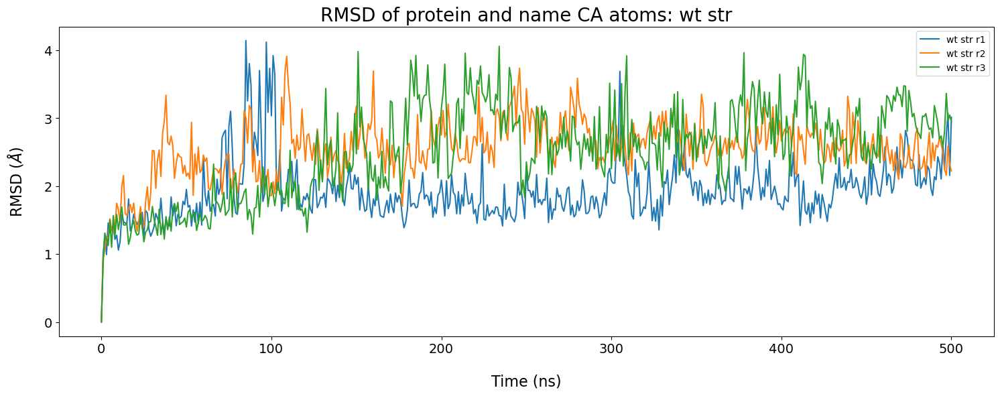

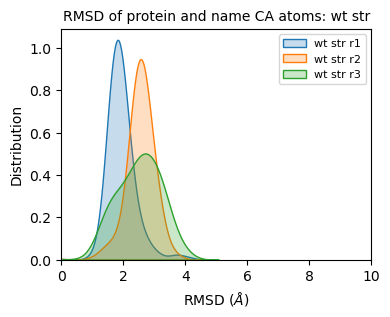

In [27]:
rmsd_plotter.onegroup(wt_str_prot_univs, 'wt str')

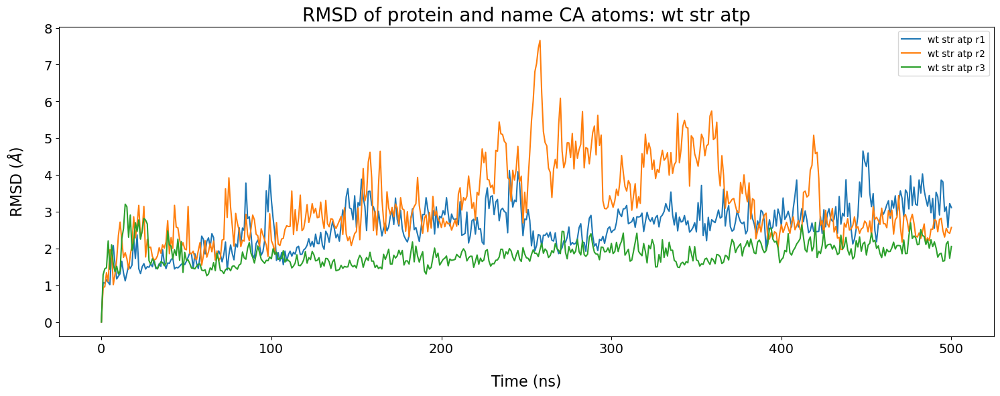

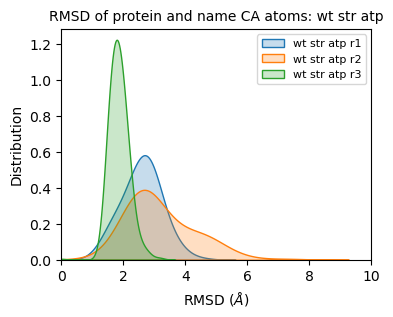

In [20]:
rmsd_plotter.onegroup(wt_str_atp_prot_univs, 'wt str atp')

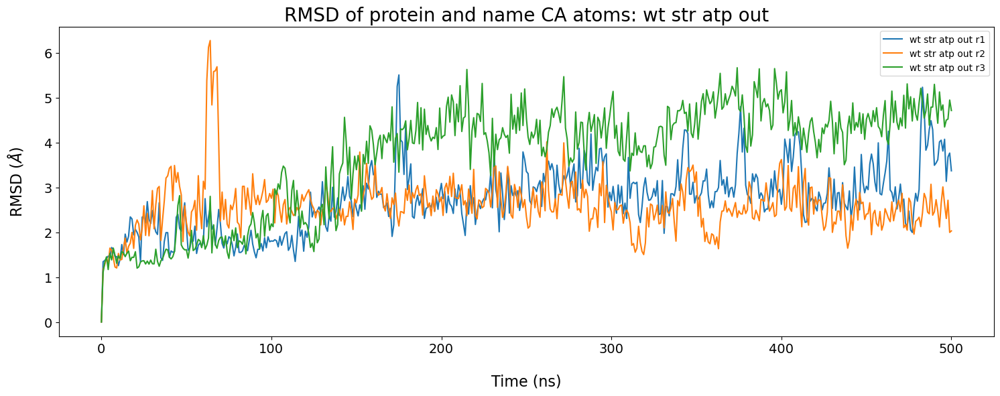

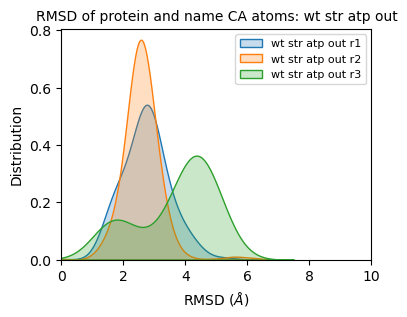

In [21]:
rmsd_plotter.onegroup(wt_str_atp_out_prot_univs, 'wt str atp out')

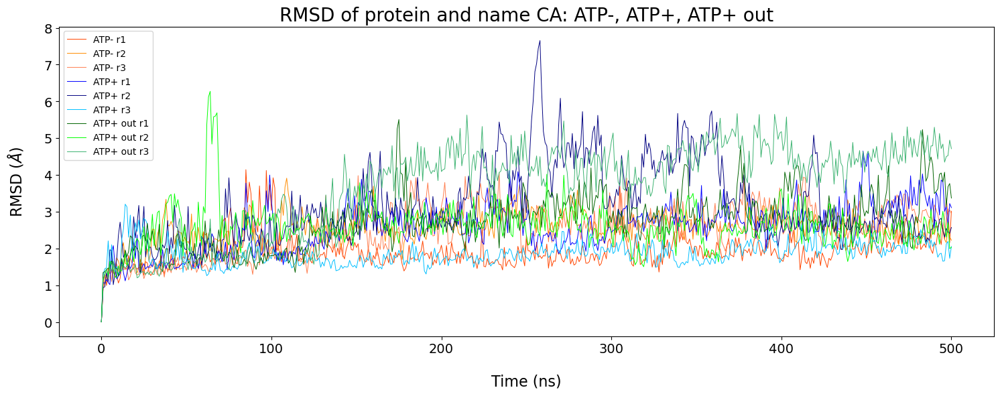

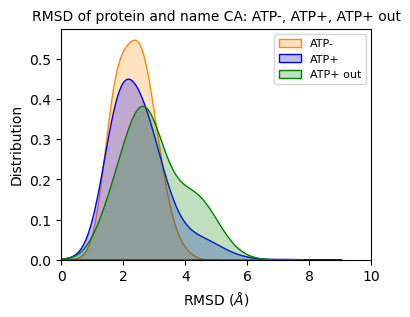

In [42]:
rmsd_plotter.groups(wt_str_prot_univs, 'ATP-',
                       wt_str_atp_prot_univs, 'ATP+',
                       wt_str_atp_out_prot_univs, "ATP+ out",
                       title= "RMSD of protein and name CA: ATP-, ATP+, ATP+ out",
                       save_plots=True, outdir=outdir)

In [ ]:
rmsd_plotter= RMSDPlotter_mda(datadir, outdir)
rmsd_plotter.set_selection("protein and name CA and resid 651-656")

### RMSF

In [17]:
rmsf_plotter= RMSFPlotter_mda(datadir, outdir)

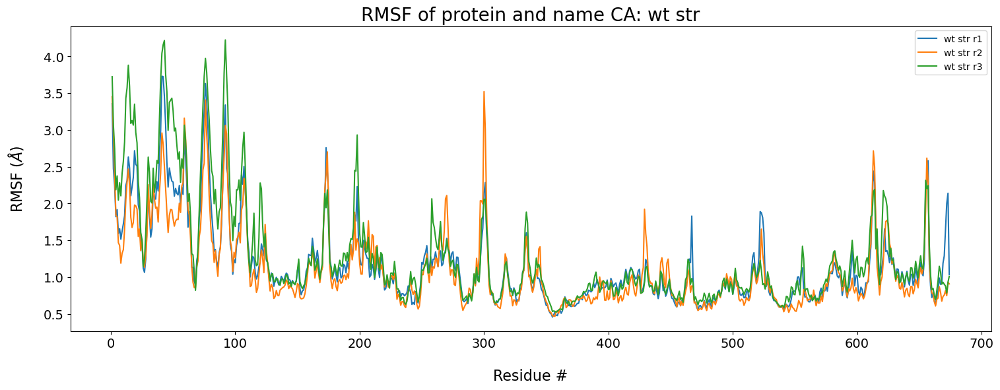

In [51]:
rmsf_plotter.onegroup(wt_str_univs, 'wt str')

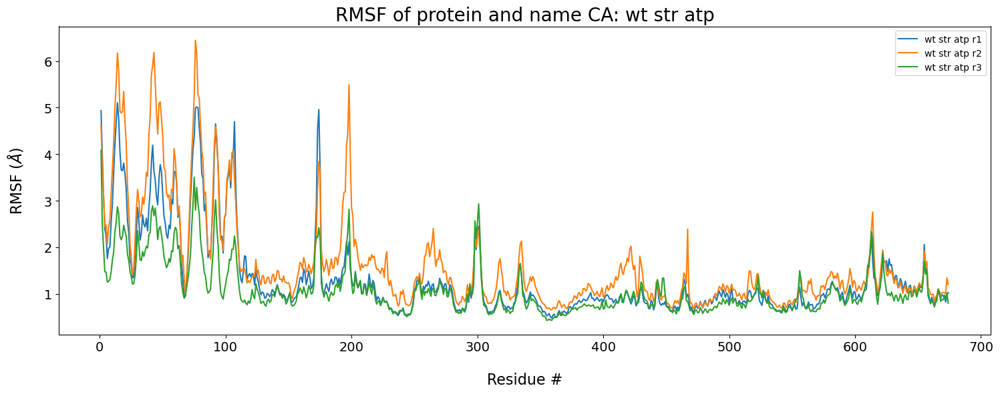

In [52]:
rmsf_plotter.onegroup(wt_str_atp_univs, 'wt str atp')

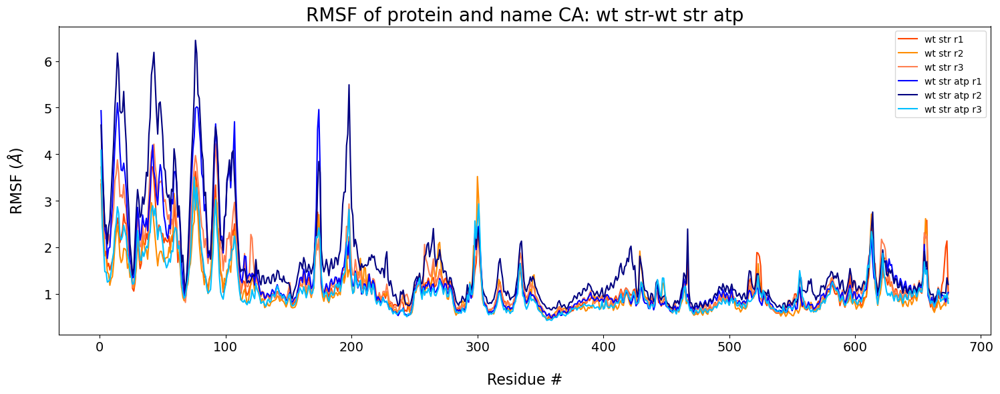

In [53]:
rmsf_plotter.twogroups(wt_str_univs, 'wt str',
                       wt_str_atp_univs, 'wt str atp')

Plot saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/rmsf_RMSF_of_protein_and_name_CA:_ATP-,_ATP+,_ATP+_out


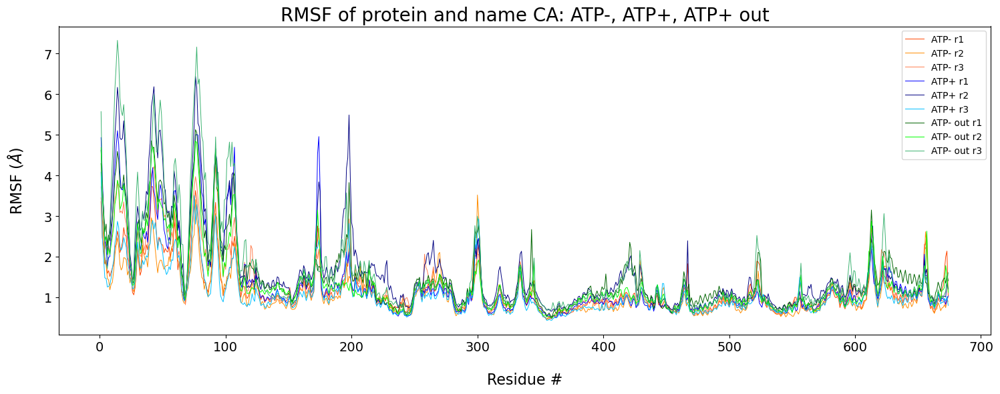

In [41]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP- out",
                    title= "RMSF of protein and name CA: ATP-, ATP+, ATP+ out",
                    linewidth=0.7, save_plots=True, outdir=outdir)

RMSF PLAT Domain

Plot saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/rmsf_RMSF_of_protein_and_name_CA_and_resid_1-116:_ATP-,_ATP+,_ATP+_out


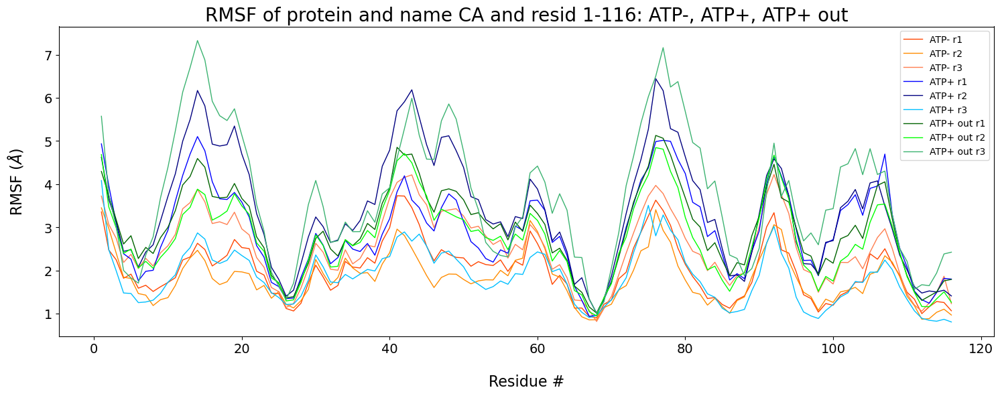

In [20]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 1-116: ATP-, ATP+, ATP+ out",
                    save_plots=True,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= PLAT_domain)

C Term A helix (KKK)

Plot saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/rmsf_RMSF_of_protein_and_name_CA_and_resid_645-660:_ATP-,_ATP+,_ATP+_out


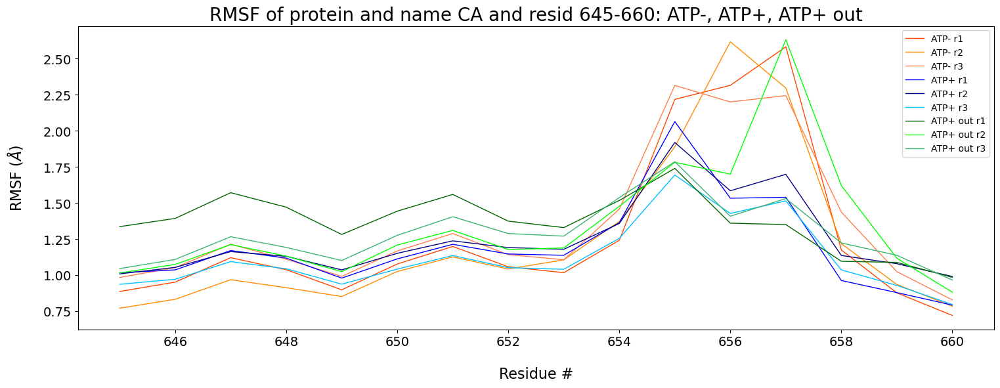

In [ ]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 645-660: ATP-, ATP+, ATP+ out",
                    save_plots=True,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= "protein and name CA and resid 645-660")

###!###

Plot saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/rmsf_RMSF_of_protein_and_name_CA_and_resid_632-662:_ATP-,_ATP+,_ATP+_out


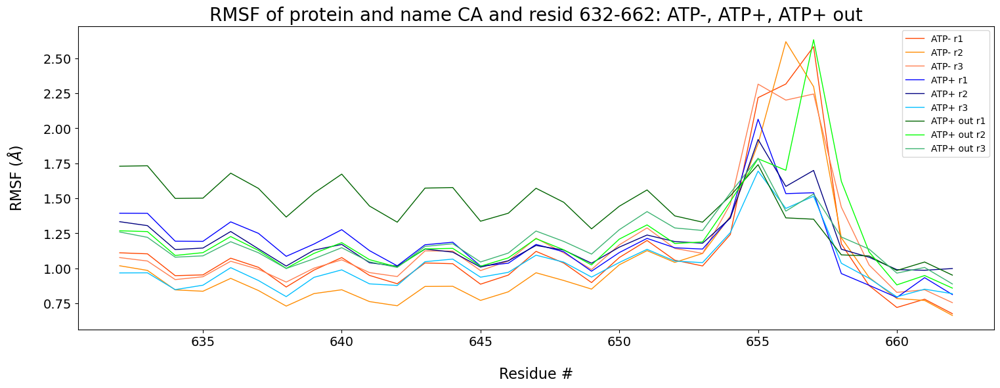

In [36]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 632-662: ATP-, ATP+, ATP+ out",
                    save_plots=True,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= "protein and name CA and resid 632-662")

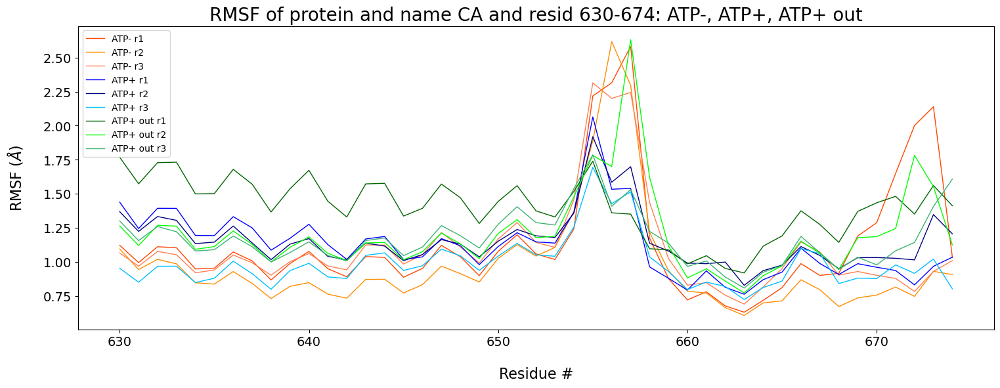

In [35]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 630-674: ATP-, ATP+, ATP+ out",
                    save_plots=False,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= "protein and name CA and resid 630-674")

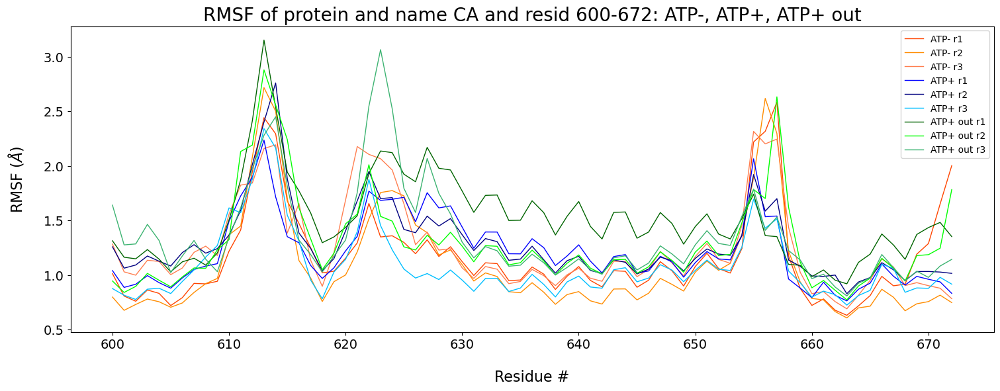

In [41]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 600-672: ATP-, ATP+, ATP+ out",
                    save_plots=False,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= "protein and name CA and resid 600-672")

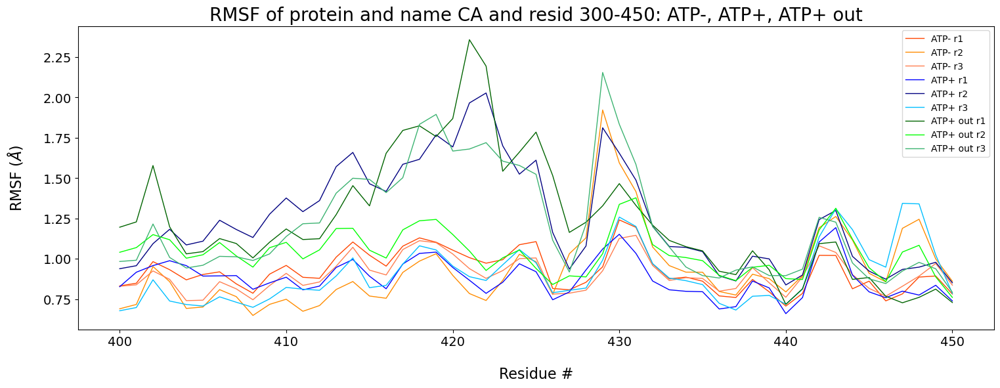

In [ ]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 400-450: ATP-, ATP+, ATP+ out",
                    save_plots=False,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= "protein and name CA and resid 400-450")

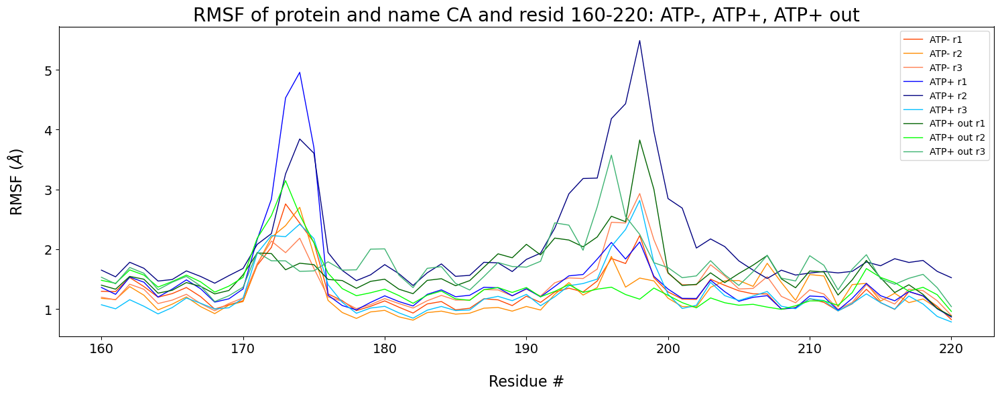

In [42]:
rmsf_plotter.groups(wt_str_prot_univs, "ATP-",
                    wt_str_atp_prot_univs, "ATP+",
                    wt_str_atp_out_prot_univs, "ATP+ out",
                    title="RMSF of protein and name CA and resid 160-220: ATP-, ATP+, ATP+ out",
                    save_plots=False,
                    outdir=outdir,
                    linewidth= 1.0,
                    selection= "protein and name CA and resid 160-220")

### Distances 

Residues 102-403 PLAT-Catalytic Domain

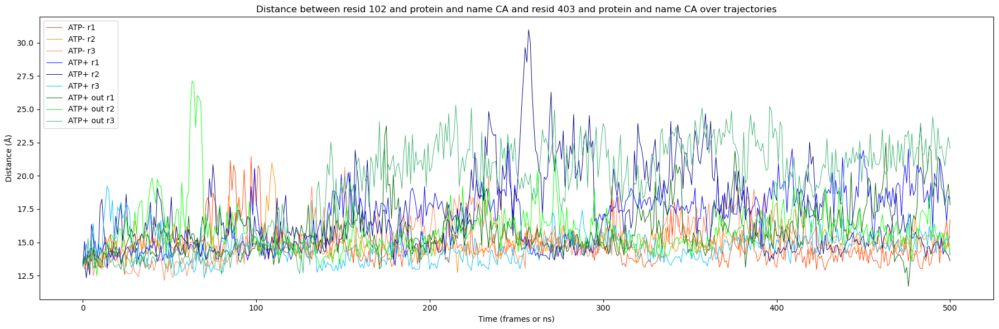

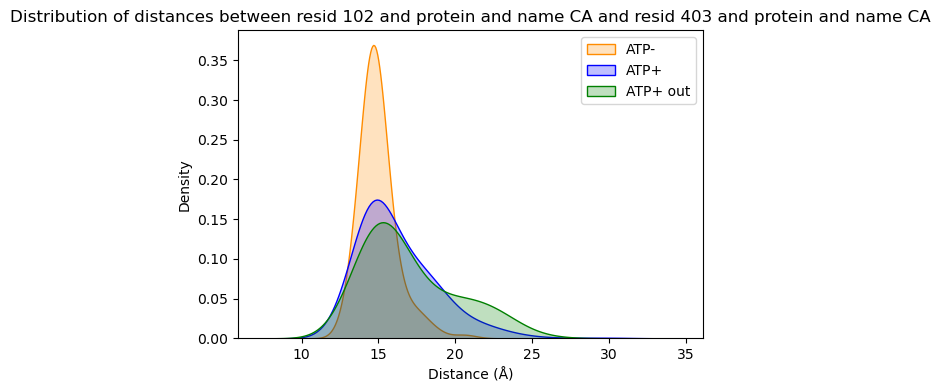


Welch's t-test between ATP- and ATP+:
  t-stat = -1.529, p-value = 2.607e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -1.825, p-value = 2.066e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 0.000, p-value = 1.000e-01

Welch's t-test between ATP+ and ATP+ out:
  t-stat = -0.566, p-value = 6.042e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 4.000, p-value = 1.000e+00


In [11]:
residue1 = "resid 102 and protein and name CA" 
residue2 = "resid 403 and protein and name CA"  
plot_distance(residue1, residue2,
              wt_str_prot_univs, "ATP-",
              wt_str_atp_prot_univs, "ATP+",
              wt_str_atp_out_prot_univs, "ATP+ out",
              save_plots=True,
              outdir=outdir
              )

Center of Mass PLAT-Calalytic domain

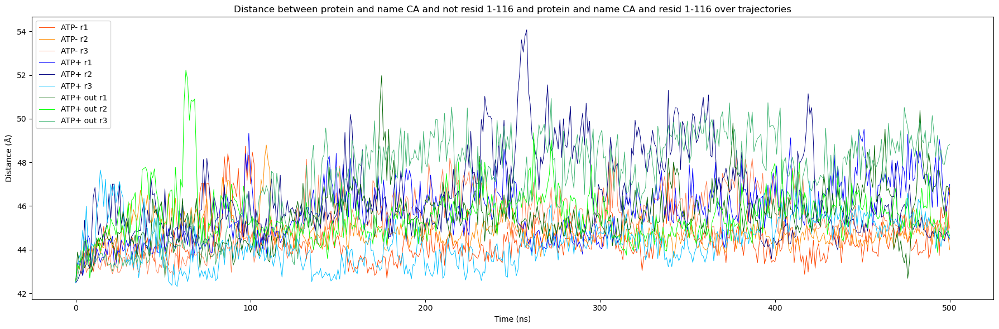

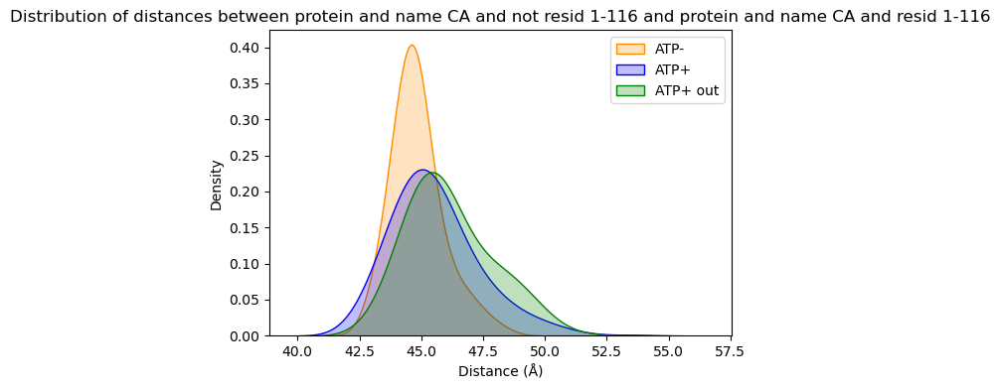

In [55]:
residue1 = "protein and name CA and not resid 1-116" 
residue2 = "protein and name CA and resid 1-116"
plot_distance(residue1, residue2,
              wt_str_prot_univs, "ATP-",
              wt_str_atp_prot_univs, "ATP+",
              wt_str_atp_out_prot_univs, "ATP+ out",
              save_plots=True,
              outdir=outdir
              )

Distance Bay Bomb

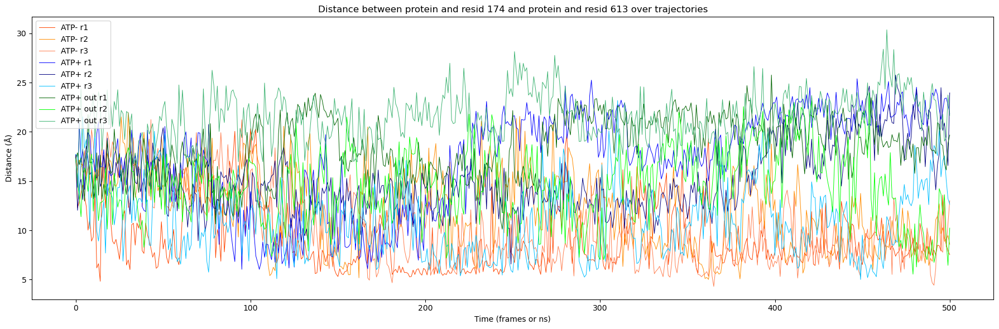

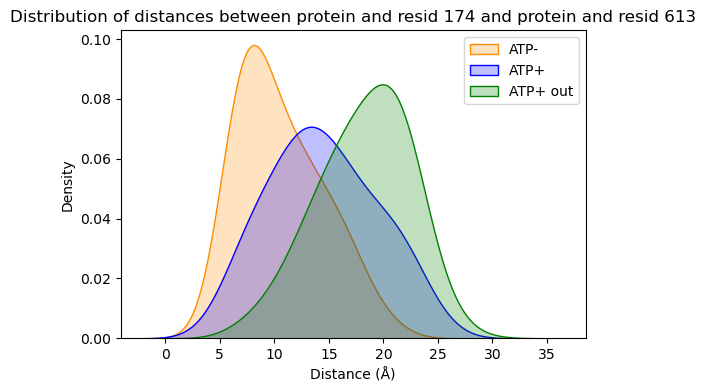


Welch's t-test between ATP- and ATP+:
  t-stat = -1.897, p-value = 1.568e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 1.000, p-value = 2.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -3.441, p-value = 4.696e-02
Mann–Whitney U test between ATP- and ATP+ out:
  U = 0.000, p-value = 1.000e-01

Welch's t-test between ATP+ and ATP+ out:
  t-stat = -1.387, p-value = 2.385e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 2.000, p-value = 4.000e-01


In [10]:
residue1 = "protein and resid 174" 
residue2 = "protein and resid 613"
plot_distance(residue1, residue2,
              wt_str_prot_univs, "ATP-",
              wt_str_atp_prot_univs, "ATP+",
              wt_str_atp_out_prot_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

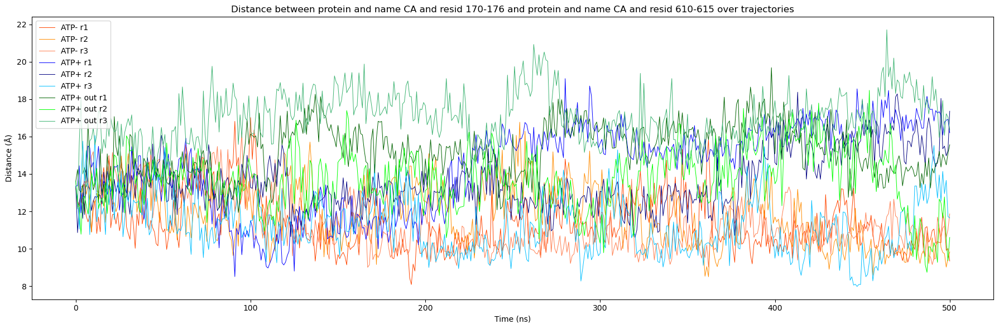

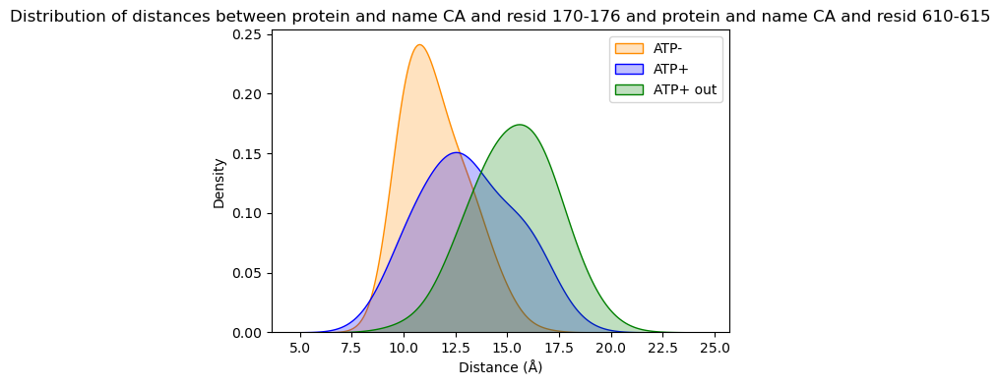

In [17]:
residue1 = "protein and name CA and resid 170-176" 
residue2 = "protein and name CA and resid 610-615"
plot_distance(residue1, residue2,
              wt_str_prot_univs, "ATP-",
              wt_str_atp_prot_univs, "ATP+",
              wt_str_atp_out_prot_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

### Fe2+ Binding

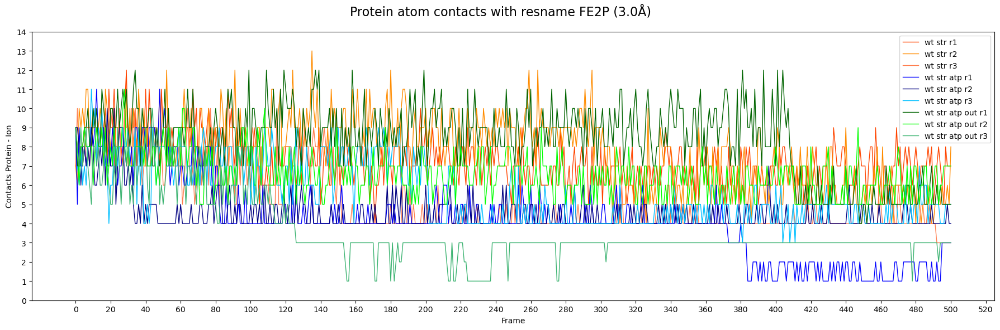

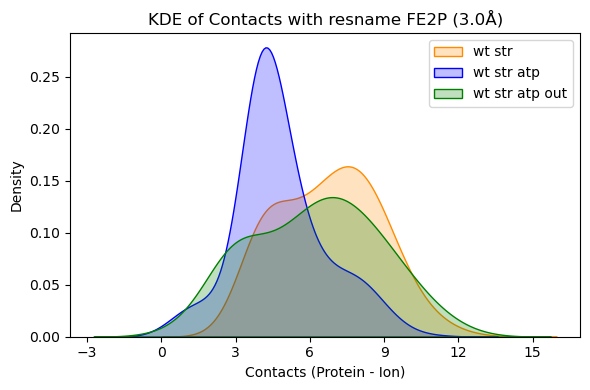

In [17]:
analysis = ContactAnalysis(
    universes_1=wt_str_syst_univs,
    universes_2=wt_str_atp_syst_univs,
    universes_3=wt_str_atp_out_syst_univs,
    protein_selection="protein",
    ion_selection="resname FE2P",
    radius=3.0,
    save_plots=True,
    outdir=outdir
)

# Run analysis with specific group labels
analysis.run_analysis("wt str", "wt str atp", "wt str atp out")

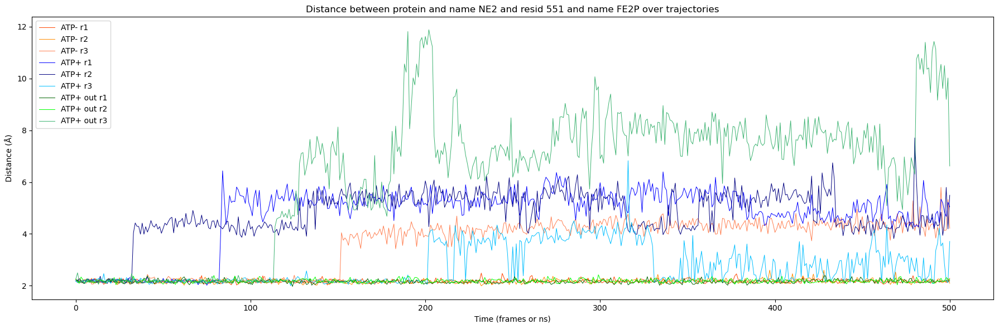

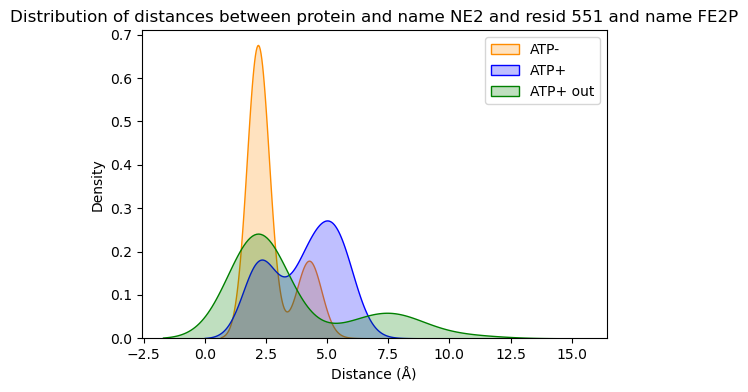


Welch's t-test between ATP- and ATP+:
  t-stat = -1.751, p-value = 1.604e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 1.000, p-value = 2.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -0.611, p-value = 5.926e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 4.000, p-value = 1.000e+00

Welch's t-test between ATP+ and ATP+ out:
  t-stat = 0.345, p-value = 7.541e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 6.000, p-value = 7.000e-01


In [27]:
residue1 = "protein and name NE2 and resid 551" 
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

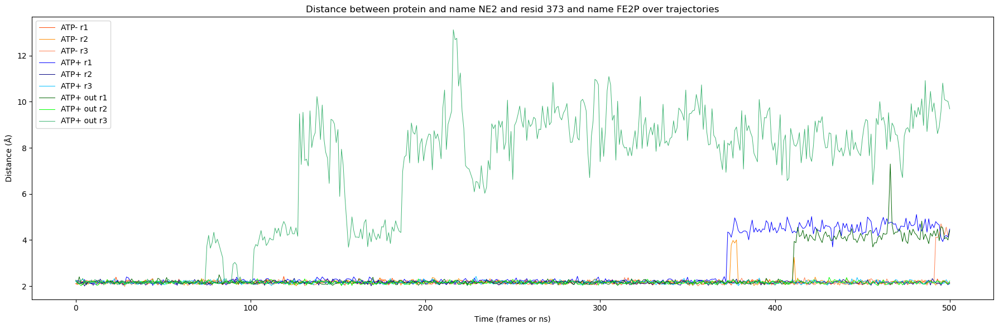

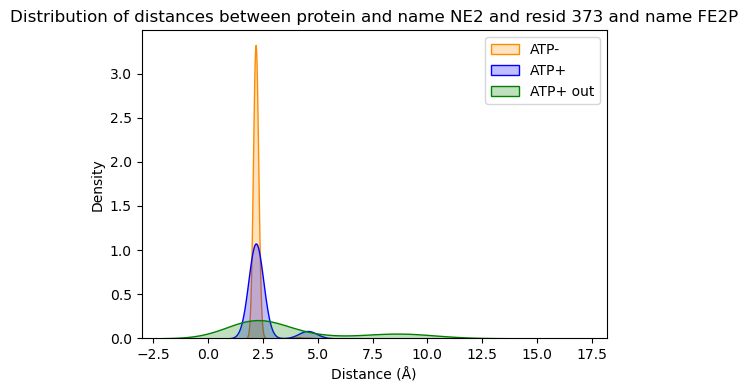


Welch's t-test between ATP- and ATP+:
  t-stat = -0.892, p-value = 4.663e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 5.000, p-value = 1.000e+00

Welch's t-test between ATP- and ATP+ out:
  t-stat = -1.107, p-value = 3.835e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP+ and ATP+ out:
  t-stat = -0.971, p-value = 4.305e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 3.000, p-value = 7.000e-01


In [28]:
residue1 = "protein and name NE2 and resid 373" 
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

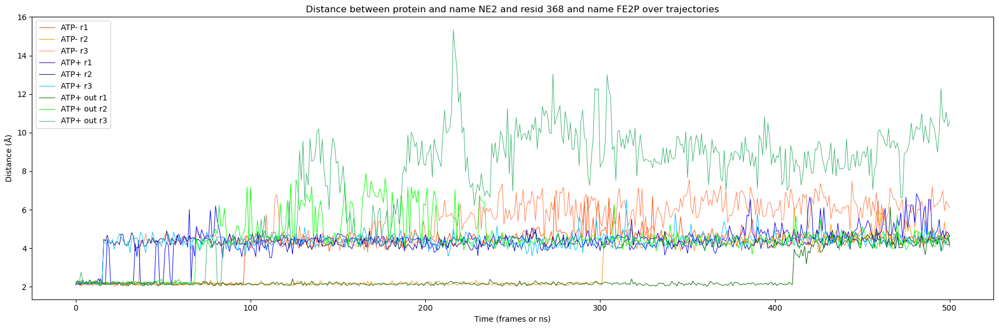

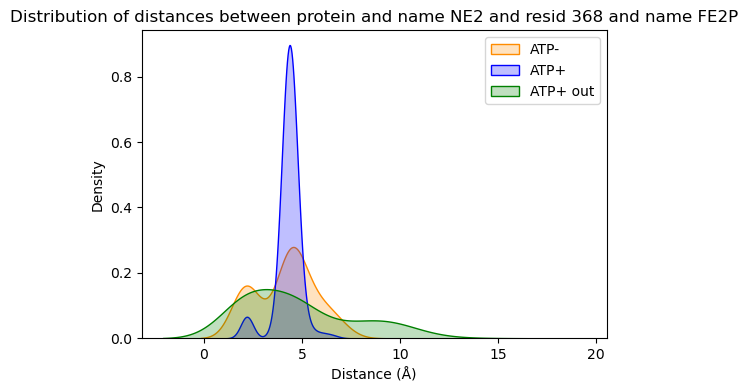


Welch's t-test between ATP- and ATP+:
  t-stat = -0.253, p-value = 8.235e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -0.406, p-value = 7.142e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 4.000, p-value = 1.000e+00

Welch's t-test between ATP+ and ATP+ out:
  t-stat = -0.331, p-value = 7.723e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 3.000, p-value = 7.000e-01


In [29]:
residue1 = "protein and name NE2 and resid 368" 
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

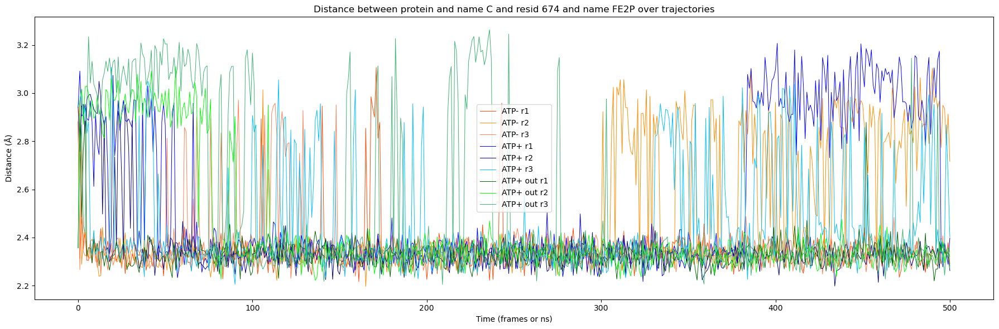

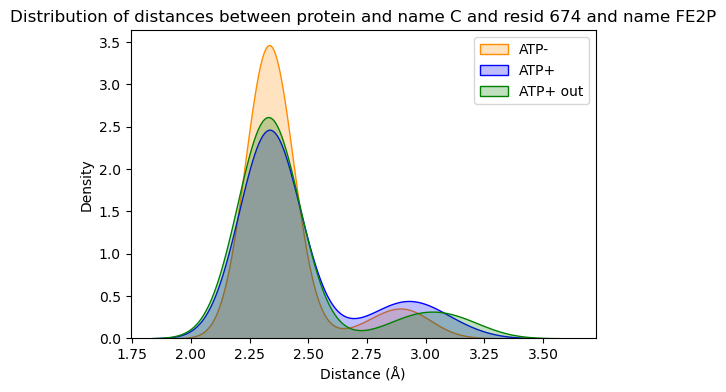


Welch's t-test between ATP- and ATP+:
  t-stat = -0.734, p-value = 5.051e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -0.393, p-value = 7.149e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 4.000, p-value = 1.000e+00

Welch's t-test between ATP+ and ATP+ out:
  t-stat = 0.311, p-value = 7.710e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 6.000, p-value = 7.000e-01


In [30]:
residue1 = "protein and name C and resid 674" 
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

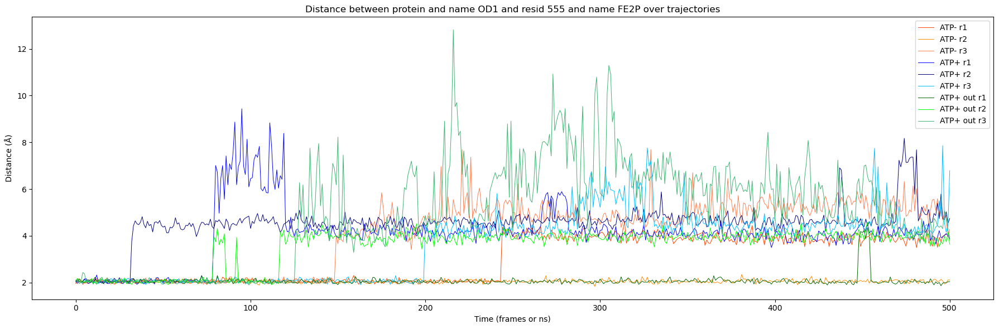

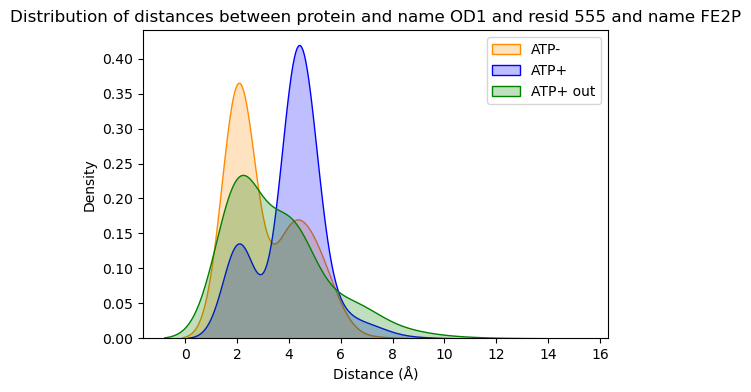


Welch's t-test between ATP- and ATP+:
  t-stat = -1.551, p-value = 2.280e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 2.000, p-value = 4.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -0.454, p-value = 6.756e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP+ and ATP+ out:
  t-stat = 0.620, p-value = 5.899e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 6.000, p-value = 7.000e-01


In [32]:
residue1 = "protein and name OD1 and resid 555" 
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

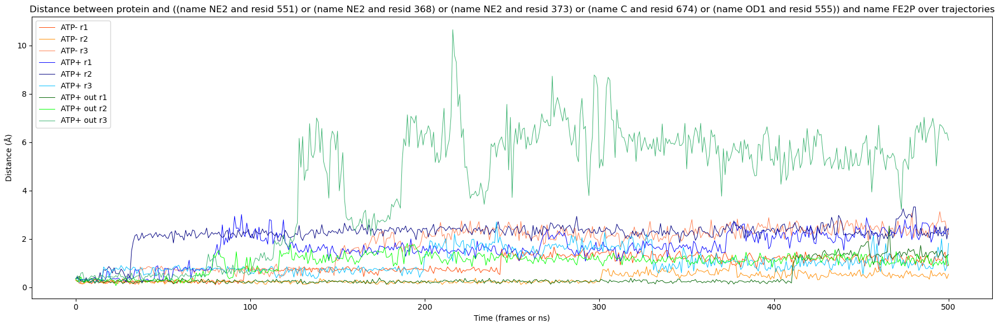

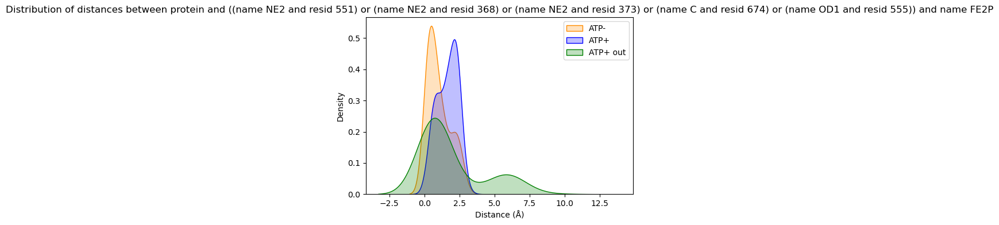


Welch's t-test between ATP- and ATP+:
  t-stat = -1.202, p-value = 2.981e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 2.000, p-value = 4.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -0.737, p-value = 5.260e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP+ and ATP+ out:
  t-stat = -0.254, p-value = 8.203e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 6.000, p-value = 7.000e-01


In [35]:
residue1 = "protein and ((name NE2 and resid 551) or (name NE2 and resid 368) or (name NE2 and resid 373) or (name C and resid 674) or (name OD1 and resid 555))"
             
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

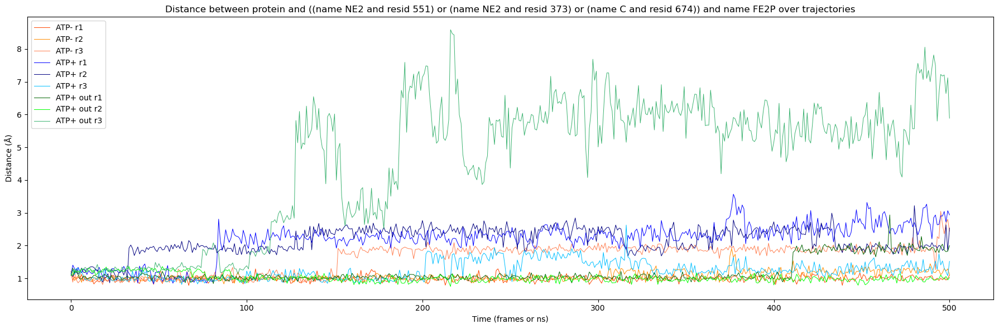

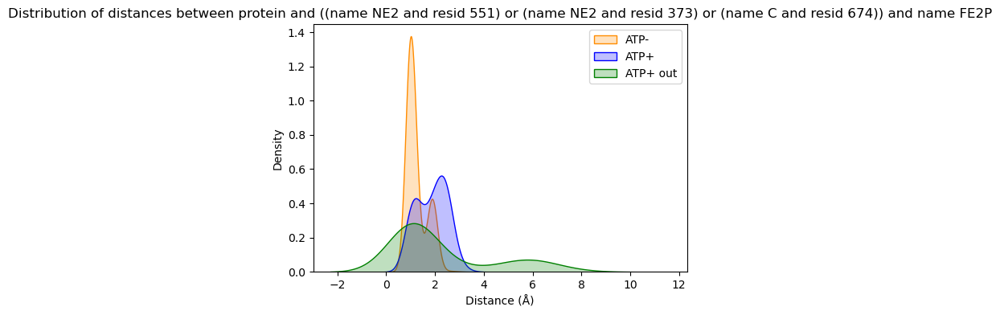


Welch's t-test between ATP- and ATP+:
  t-stat = -1.716, p-value = 1.724e-01
Mann–Whitney U test between ATP- and ATP+:
  U = 1.000, p-value = 2.000e-01

Welch's t-test between ATP- and ATP+ out:
  t-stat = -0.878, p-value = 4.680e-01
Mann–Whitney U test between ATP- and ATP+ out:
  U = 3.000, p-value = 7.000e-01

Welch's t-test between ATP+ and ATP+ out:
  t-stat = -0.342, p-value = 7.616e-01
Mann–Whitney U test between ATP+ and ATP+ out:
  U = 6.000, p-value = 7.000e-01


In [41]:
residue1 = "protein and ((name NE2 and resid 551) or (name NE2 and resid 373) or (name C and resid 674))"
             
residue2 = "name FE2P"
plot_distance(residue1, residue2,
              wt_str_syst_univs, "ATP-",
              wt_str_atp_syst_univs, "ATP+",
              wt_str_atp_out_syst_univs, "ATP+ out",
              save_plots=False,
              outdir=outdir
              )

### Dynamic Cross Correlation (Pearson)

#### Merged Univs

0 501


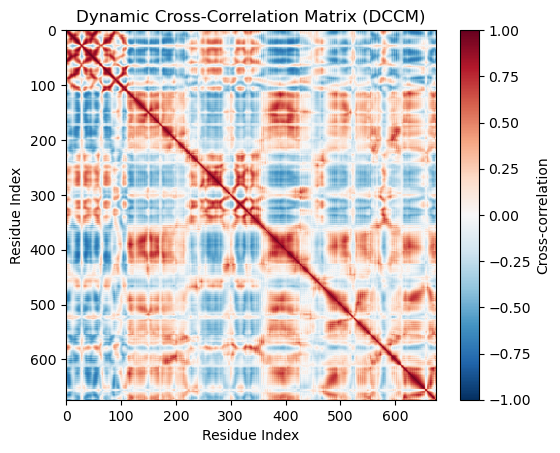

In [37]:
dccm_wt_str= pearson_DCCM(wt_str_merged_univ)

0 1503


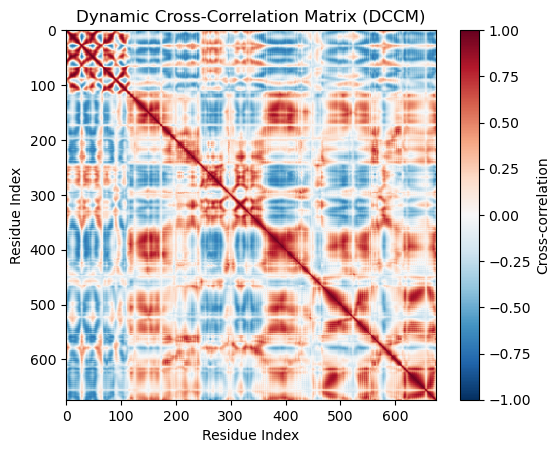

In [38]:
dccm_wt_str_atp =pearson_DCCM(wt_str_atp_merged_univ)

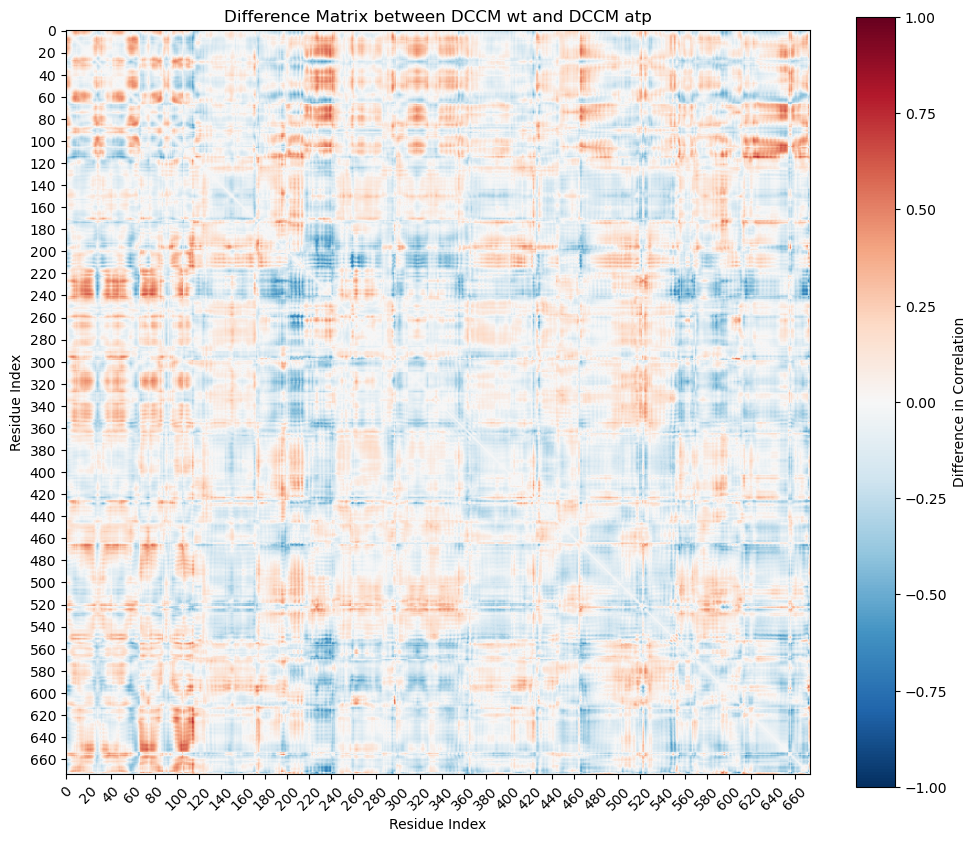

In [ ]:
# difference_matrix=DCCM1​−DCCM2
#This matrix will have positive values where correlations in DCCM_1 are stronger (or anticorrelation in DCCM_2 is stronger), 
#negative values where correlations in DCCM_2 are stronger, and values close to zero where the correlations are similar.
diff_dccm= (dccm_wt_str - dccm_wt_str_atp)
plt.figure(figsize=(12, 10))
plt.imshow(diff_dccm, cmap="RdBu_r", vmin=-1, vmax=1)

plt.colorbar(label="Difference in Correlation")
plt.title("Difference Matrix between DCCM wt and DCCM atp")
plt.xlabel("Residue Index")
plt.ylabel("Residue Index")
num_residues = diff_dccm.shape[0]  
plt.xticks(np.arange(0, num_residues, 20), rotation=45)
plt.yticks(np.arange(0, num_residues, 20))

plt.show()

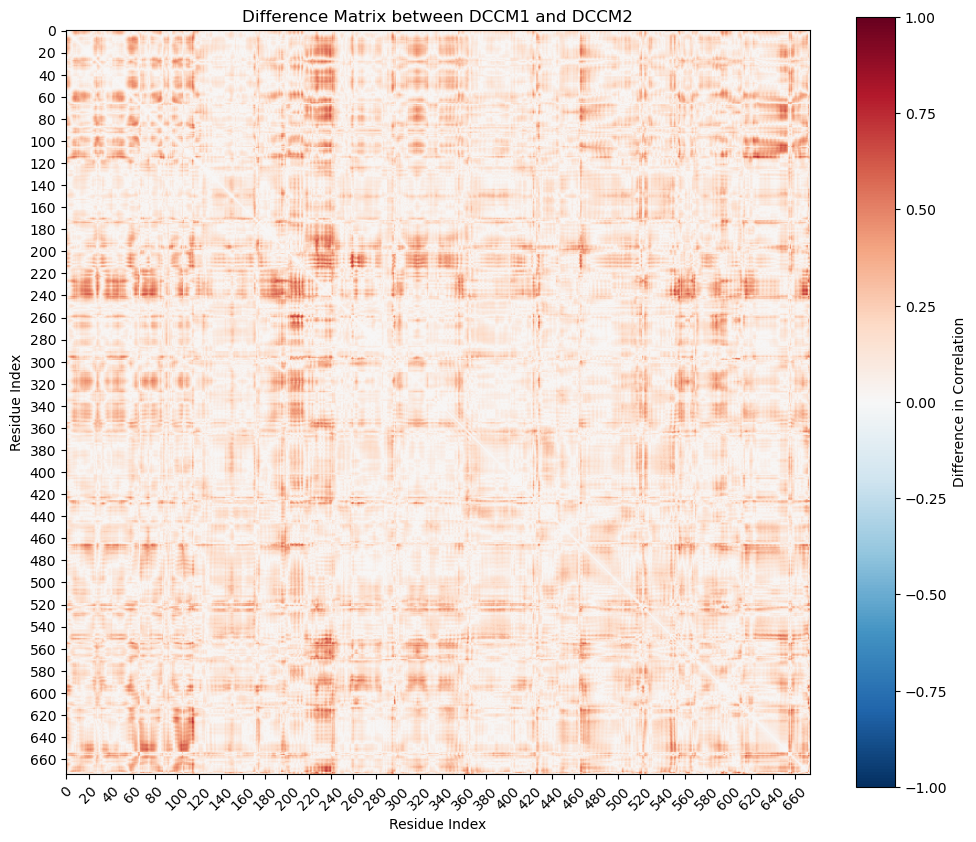

In [59]:
# Difference matrix

diff_dccm= np.abs(dccm_wt_str - dccm_wt_str_atp)
plt.figure(figsize=(12, 10))
plt.imshow(diff_dccm, cmap="RdBu_r", vmin=-1, vmax=1)
plt.colorbar(label="Difference in Correlation")
plt.title("Difference Matrix between DCCM1 and DCCM2")
plt.xlabel("Residue Index")
plt.ylabel("Residue Index")
num_residues = diff_dccm.shape[0]  # Assuming the matrix is square
plt.xticks(np.arange(0, num_residues, 20), rotation=45)
plt.yticks(np.arange(0, num_residues, 20))

plt.show()

In [ ]:
# Top values to extract
top_n = 300 

# Flatten the matrix and get the sorted indices for the highest values
flattened_diff = diff_dccm.flatten()
sorted_indices = np.argsort(flattened_diff)[::-1]  # Sort in descending order

top_indices = sorted_indices[:top_n]

# Map the flattened indices back to 2D residue indices
top_residue_pairs = [(idx // diff_dccm.shape[1], idx % diff_dccm.shape[1]) for idx in top_indices]

top_values = flattened_diff[top_indices]
for pair, value in zip(top_residue_pairs, top_values):
    print(f"Residue pair: {pair}, Difference value: {value}")

Residue pair: (626, 114), Difference value: 0.75392671336406
Residue pair: (114, 626), Difference value: 0.75392671336406
Residue pair: (627, 114), Difference value: 0.7105162069672389
Residue pair: (114, 627), Difference value: 0.7105162069672388
Residue pair: (624, 114), Difference value: 0.7007536609507135
Residue pair: (114, 624), Difference value: 0.7007536609507135
Residue pair: (623, 114), Difference value: 0.6976660596316439
Residue pair: (114, 623), Difference value: 0.6976660596316439
Residue pair: (625, 114), Difference value: 0.6854644915921942
Residue pair: (114, 625), Difference value: 0.6854644915921941
Residue pair: (626, 115), Difference value: 0.6657121781702728
Residue pair: (115, 626), Difference value: 0.6657121781702728
Residue pair: (115, 627), Difference value: 0.6644728427550662
Residue pair: (627, 115), Difference value: 0.6644728427550662
Residue pair: (104, 648), Difference value: 0.6519947230635457
Residue pair: (648, 104), Difference value: 0.6519947230635

In [ ]:
""" EXPORT RESIDUE PAIRS FOR PYMOL VISUALIZATION"""
pymol_script_path = "/home/fede/Desktop/top_residue_pairs.pml"

with open(pymol_script_path, "w") as pymol_script:
    pymol_script.write("# PyMOL script to show measurements between top residue pairs\n")
    
    # Loop through each top residue pair and write the distance command for each
    for index, ((res1, res2), value) in enumerate(zip(top_residue_pairs, top_values), start=1):
        pymol_script.write(f"distance pair_{index}, /wt_str_atp_r2///{res1+1}/CA, /wt_str_atp_r2///{res2+1}/CA\n")
        pymol_script.write(f"# Residue pair: ({res1+1}, {res2+1}), Difference value: {value:.2f}\n")

    pymol_script.write("hide labels, all\n")  

print(f"PyMOL script saved as '{pymol_script_path}'")

PyMOL script saved as '/home/fede/Desktop/top_residue_pairs.pml'


#### Background

### PCA Merged

#### Each merged universe independently

In [21]:
pca_wt_str, var_wt_str= pca_general(wt_str_merged_univ, select="protein and name CA", n_components= None, frames= None)
pca_wt_str_atp, var_wt_str_atp= pca_general(wt_str_atp_merged_univ, select="protein and name CA", n_components= None, frames= None)
pca_wt_str_atp_out, var_wt_str_atp_out= pca_general(wt_str_atp_out_merged_univ, select="protein and name CA", n_components= None, frames= None)

NameError: name 'wt_str_merged_univ' is not defined

#### Projection on merged PC space

There are 674 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


Mean Calculation:   0%|          | 0/4509 [00:00<?, ?it/s]

  0%|          | 0/4509 [00:00<?, ?it/s]

Done

PCA (eigenvectors x eigenvalues) shape: (2022, 2022)

Cumulated variance PC1: 0.364 	 Uncumulated variance PC1: 0.364
Cumulated variance PC2: 0.564 	 Uncumulated variance PC2: 0.200
Cumulated variance PC3: 0.685 	 Uncumulated variance PC3: 0.121
Cumulated variance PC4: 0.712 	 Uncumulated variance PC4: 0.027
Cumulated variance PC5: 0.735 	 Uncumulated variance PC5: 0.023
Cumulated variance PC6: 0.753 	 Uncumulated variance PC6: 0.018
Cumulated variance PC7: 0.767 	 Uncumulated variance PC7: 0.014
Cumulated variance PC8: 0.779 	 Uncumulated variance PC8: 0.012
Cumulated variance PC9: 0.790 	 Uncumulated variance PC9: 0.011
Cumulated variance PC10: 0.801 	 Uncumulated variance PC10: 0.011




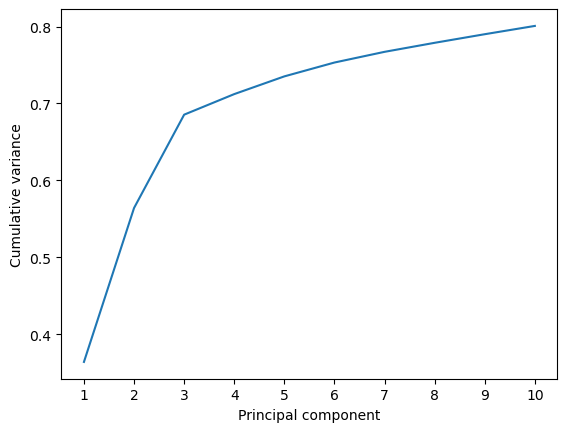

In [22]:
pca_merged_merged, var_merged_merged= pca_general(u_merged_merged, select="protein and name CA", n_components= None, frames= None)

FULL MERGED OF MERGED

Last 0-based frame of the full universe: 4508
Plotting the full transformed trajectory (4509 frames)
Plot saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/pca_projection.png


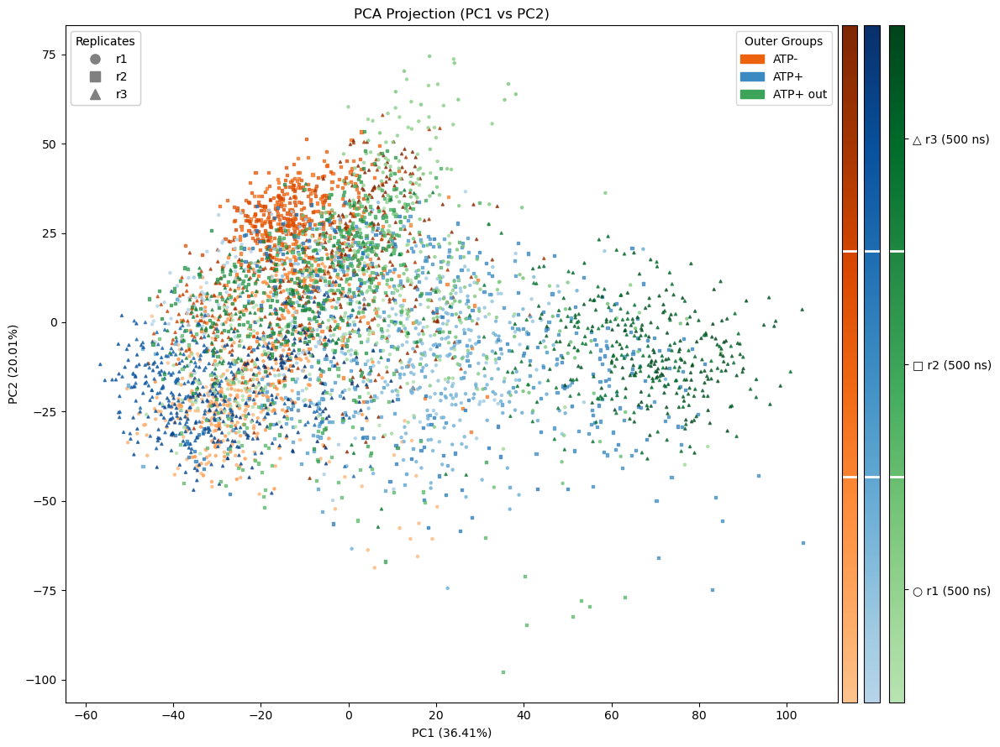

In [33]:
project_pca(pca=pca_merged_merged, 
            universe=u_merged_merged, 
            variance=var_merged_merged,  
            title= "PCA Projection (PC1 vs PC2)",
            subsets_legends= ["ATP-", "ATP+", "ATP+ out"],
            save_plot=True,
            outdir=outdir,
            n_divisions=3)

Last 0-based frame of the full universe: 4508
Plotting the full transformed trajectory (4509 frames)


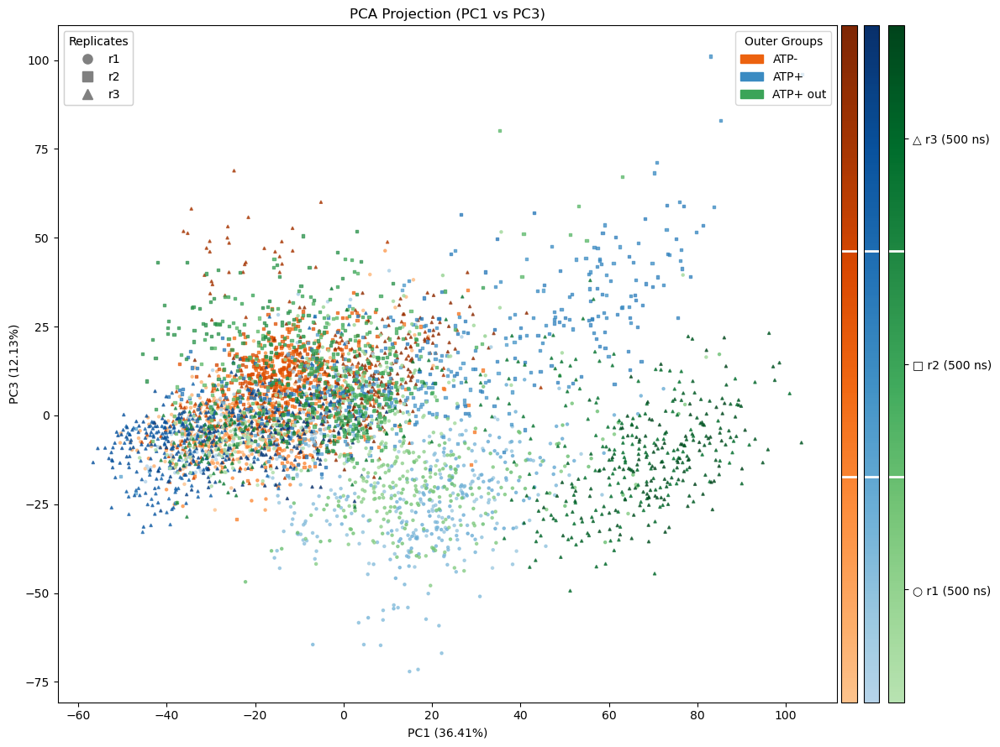

In [ ]:
project_pca(pca=pca_merged_merged, 
            universe=u_merged_merged, 
            variance=var_merged_merged,
            pc_index_1=0, pc_index_2=2,
            title= "PCA Projection (PC1 vs PC3)",
            subsets_legends= ["ATP-", "ATP+", "ATP+ out"],
            save_plot=False,
            n_divisions=3)

In [62]:
# Export PC motion vector 

pc_vector_motion(
    pca_merged_merged, u_merged_merged, selection="protein and name CA",
    pc_index=0, 
    steps=10, 
    scale=2.0,
    loop=True,
    export=True,
    filename="PC1_merged_merged.pdb",
    outdir=outdir
)

pc_vector_motion(
    pca_merged_merged, u_merged_merged, selection="protein and name CA",
    pc_index=1, 
    steps=10, 
    scale=2.0,
    loop=True,
    export=True,
    filename="PC2_merged_merged.pdb",
    outdir=outdir
)

pc_vector_motion(
    pca_merged_merged, u_merged_merged, selection="protein and name CA",
    pc_index=2, 
    steps=10, 
    scale=2.0,
    loop=True,
    export=True,
    filename="PC3_merged_merged.pdb",
    outdir=outdir
)

/home/fede/miniconda3/envs/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/coordinates/PDB.py:777: UserWarning: Unit cell dimensions not found. CRYST1 record set to unitary values.
  warnings.warn("Unit cell dimensions not found. "
/home/fede/miniconda3/envs/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/coordinates/PDB.py:1153: UserWarning: Found no information for attr: 'altLocs' Using default value of ' '
  warnings.warn("Found no information for attr: '{}'"
/home/fede/miniconda3/envs/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/coordinates/PDB.py:1153: UserWarning: Found no information for attr: 'icodes' Using default value of ' '
  warnings.warn("Found no information for attr: '{}'"
/home/fede/miniconda3/envs/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/coordinates/PDB.py:1153: UserWarning: Found no information for attr: 'chainIDs' Using default value of ''
  warnings.warn("Found no information for attr: '{}'"
/home/fede/miniconda3/envs/env_m

PC vector motion saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/PC1_merged_merged.pdb
PC vector motion saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/PC2_merged_merged.pdb
PC vector motion saved to /home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/PC3_merged_merged.pdb


<Universe with 674 atoms>

### PCA RMSIP Merged

#### Excluding PLAT

There are 558 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:03<00:00, 483.04it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (1674, 1674)

Cumulated variance PC1: 0.137 	 Uncumulated variance PC1: 0.137
Cumulated variance PC2: 0.264 	 Uncumulated variance PC2: 0.127
Cumulated variance PC3: 0.319 	 Uncumulated variance PC3: 0.055
Cumulated variance PC4: 0.365 	 Uncumulated variance PC4: 0.046
Cumulated variance PC5: 0.403 	 Uncumulated variance PC5: 0.038
Cumulated variance PC6: 0.437 	 Uncumulated variance PC6: 0.034
Cumulated variance PC7: 0.465 	 Uncumulated variance PC7: 0.028
Cumulated variance PC8: 0.488 	 Uncumulated variance PC8: 0.024
Cumulated variance PC9: 0.511 	 Uncumulated variance PC9: 0.023
Cumulated variance PC10: 0.529 	 Uncumulated variance PC10: 0.017


There are 558 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:03<00:00, 464.23it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (1674, 1674)

Cumulated variance PC1: 0.184 	 Uncumulated variance PC1: 0.184
Cumulated variance PC2: 0.299 	 Uncumulated variance PC2: 0.115
Cumulated variance PC3: 0.398 	 Uncumulated variance PC3: 0.099
Cumulated variance PC4: 0.447 	 Uncumulated variance PC4: 0.050
Cumulated variance PC5: 0.485 	 Uncumulated variance PC5: 0.038
Cumulated variance PC6: 0.519 	 Uncumulated variance PC6: 0.034
Cumulated variance PC7: 0.542 	 Uncumulated variance PC7: 0.023
Cumulated variance PC8: 0.562 	 Uncumulated variance PC8: 0.020
Cumulated variance PC9: 0.578 	 Uncumulated variance PC9: 0.016
Cumulated variance PC10: 0.593 	 Uncumulated variance PC10: 0.015


There are 558 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:03<00:00, 486.84it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (1674, 1674)

Cumulated variance PC1: 0.239 	 Uncumulated variance PC1: 0.239
Cumulated variance PC2: 0.356 	 Uncumulated variance PC2: 0.117
Cumulated variance PC3: 0.417 	 Uncumulated variance PC3: 0.061
Cumulated variance PC4: 0.460 	 Uncumulated variance PC4: 0.043
Cumulated variance PC5: 0.492 	 Uncumulated variance PC5: 0.032
Cumulated variance PC6: 0.518 	 Uncumulated variance PC6: 0.027
Cumulated variance PC7: 0.543 	 Uncumulated variance PC7: 0.025
Cumulated variance PC8: 0.562 	 Uncumulated variance PC8: 0.019
Cumulated variance PC9: 0.580 	 Uncumulated variance PC9: 0.018
Cumulated variance PC10: 0.597 	 Uncumulated variance PC10: 0.017




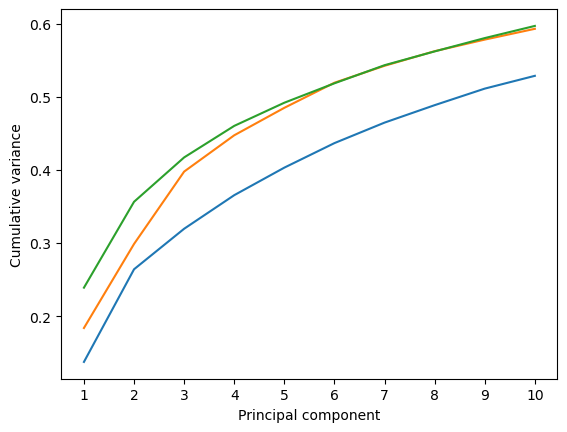

In [51]:
pca_wt_str, var_wt_str= pca_general(wt_str_merged_univ, select="protein and name CA and not resid 1-116", n_components= None, frames= None)
pca_wt_str_atp, var_wt_str_atp= pca_general(wt_str_atp_merged_univ, select="protein and name CA and not resid 1-116", n_components= None, frames= None)
pca_wt_str_atp_out, var_wt_str_atp_out= pca_general(wt_str_atp_out_merged_univ, select="protein and name CA and not resid 1-116", n_components= None, frames= None)

In [52]:
print (pca_wt_str.rmsip(pca_wt_str_atp,n_components=10))
print (pca_wt_str_atp_out.rmsip(pca_wt_str_atp,n_components=10))
print (pca_wt_str.rmsip(pca_wt_str_atp_out,n_components=10))

0.4024206353483829
0.600249360139017
0.35214100697830997


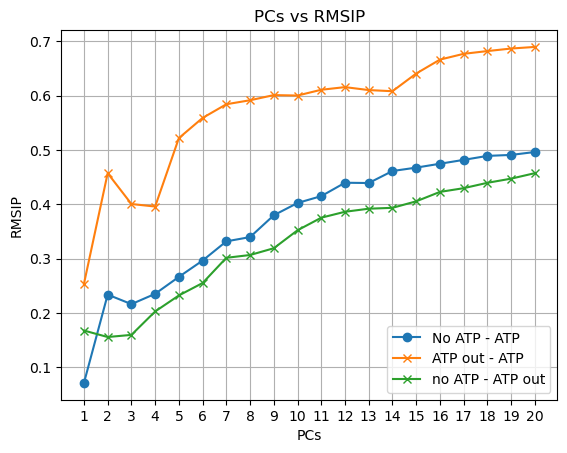

In [53]:
i_values, noatp_atp_values, atpout_atp_values, noatp_atpout_values= [], [], [], []

for i in range(1, 21):
    noatp_atp = pca_wt_str.rmsip(pca_wt_str_atp, n_components=i)
    atp_out_atp = pca_wt_str_atp_out.rmsip(pca_wt_str_atp, n_components=i)
    noatp_atpout = pca_wt_str.rmsip(pca_wt_str_atp_out, n_components=i)
    
    i_values.append(i)
    noatp_atp_values.append(noatp_atp)
    atpout_atp_values.append(atp_out_atp)
    noatp_atpout_values.append(noatp_atpout)

plt.plot(i_values, noatp_atp_values, marker='o', label="No ATP - ATP")
plt.plot(i_values, atpout_atp_values, marker='x', label="ATP out - ATP")
plt.plot(i_values, noatp_atpout_values, marker='x', label="no ATP - ATP out")
plt.xlabel('PCs')
x_ticks= np.arange(1, len(i_values)+1, 1)
plt.xticks(x_ticks)
plt.ylabel('RMSIP')
plt.title('PCs vs RMSIP')
plt.grid(True)
plt.legend()

plt.show()

#### Including PLAT

There are 674 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:06<00:00, 245.59it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (2022, 2022)

Cumulated variance PC1: 0.393 	 Uncumulated variance PC1: 0.393
Cumulated variance PC2: 0.532 	 Uncumulated variance PC2: 0.139
Cumulated variance PC3: 0.617 	 Uncumulated variance PC3: 0.085
Cumulated variance PC4: 0.658 	 Uncumulated variance PC4: 0.041
Cumulated variance PC5: 0.693 	 Uncumulated variance PC5: 0.035
Cumulated variance PC6: 0.711 	 Uncumulated variance PC6: 0.018
Cumulated variance PC7: 0.727 	 Uncumulated variance PC7: 0.016
Cumulated variance PC8: 0.741 	 Uncumulated variance PC8: 0.014
Cumulated variance PC9: 0.753 	 Uncumulated variance PC9: 0.013
Cumulated variance PC10: 0.765 	 Uncumulated variance PC10: 0.012


There are 674 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:06<00:00, 240.86it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (2022, 2022)

Cumulated variance PC1: 0.417 	 Uncumulated variance PC1: 0.417
Cumulated variance PC2: 0.587 	 Uncumulated variance PC2: 0.170
Cumulated variance PC3: 0.713 	 Uncumulated variance PC3: 0.126
Cumulated variance PC4: 0.745 	 Uncumulated variance PC4: 0.032
Cumulated variance PC5: 0.774 	 Uncumulated variance PC5: 0.029
Cumulated variance PC6: 0.795 	 Uncumulated variance PC6: 0.021
Cumulated variance PC7: 0.813 	 Uncumulated variance PC7: 0.017
Cumulated variance PC8: 0.823 	 Uncumulated variance PC8: 0.011
Cumulated variance PC9: 0.832 	 Uncumulated variance PC9: 0.009
Cumulated variance PC10: 0.840 	 Uncumulated variance PC10: 0.008


There are 674 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 903/903 [00:03<00:00, 239.99it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (2022, 2022)

Cumulated variance PC1: 0.390 	 Uncumulated variance PC1: 0.390
Cumulated variance PC2: 0.628 	 Uncumulated variance PC2: 0.238
Cumulated variance PC3: 0.728 	 Uncumulated variance PC3: 0.101
Cumulated variance PC4: 0.772 	 Uncumulated variance PC4: 0.043
Cumulated variance PC5: 0.798 	 Uncumulated variance PC5: 0.026
Cumulated variance PC6: 0.819 	 Uncumulated variance PC6: 0.021
Cumulated variance PC7: 0.830 	 Uncumulated variance PC7: 0.011
Cumulated variance PC8: 0.839 	 Uncumulated variance PC8: 0.009
Cumulated variance PC9: 0.847 	 Uncumulated variance PC9: 0.008
Cumulated variance PC10: 0.854 	 Uncumulated variance PC10: 0.007




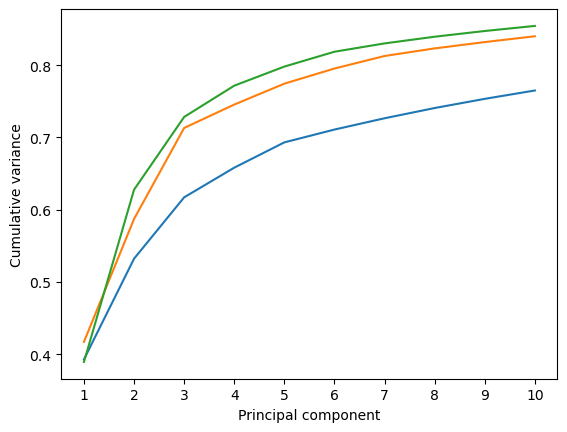

In [8]:
pca_wt_str, var_wt_str= pca_general(wt_str_merged_univ, select="protein and name CA", n_components= None, frames= None)
pca_wt_str_atp, var_wt_str_atp= pca_general(wt_str_atp_merged_univ, select="protein and name CA", n_components= None, frames= None)
pca_wt_str_atp_out, var_wt_str_atp_out= pca_general(wt_str_atp_out_merged_univ, select="protein and name CA", n_components= None, frames= None)

In [9]:
print (pca_wt_str.rmsip(pca_wt_str_atp,n_components=10))
print (pca_wt_str_atp_out.rmsip(pca_wt_str_atp,n_components=10))
print (pca_wt_str.rmsip(pca_wt_str_atp_out,n_components=10))

0.4860709542837432
0.7520210256666466
0.5131272041201976


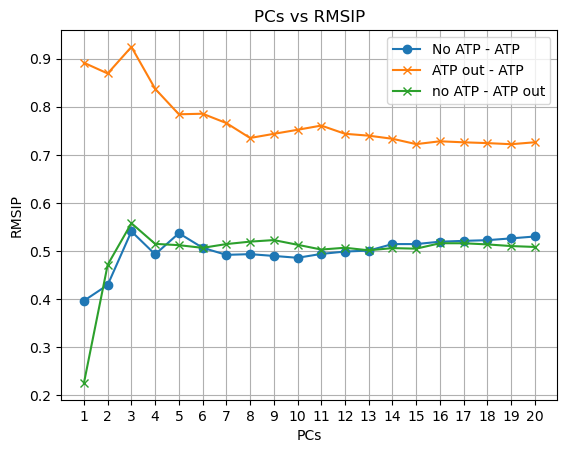

In [17]:
i_values, noatp_atp_values, atpout_atp_values, noatp_atpout_values= [], [], [], []


for i in range(1, 21):
    noatp_atp = pca_wt_str.rmsip(pca_wt_str_atp, n_components=i)
    atp_out_atp = pca_wt_str_atp_out.rmsip(pca_wt_str_atp, n_components=i)
    noatp_atpout = pca_wt_str.rmsip(pca_wt_str_atp_out, n_components=i)
    
    i_values.append(i)
    noatp_atp_values.append(noatp_atp)
    atpout_atp_values.append(atp_out_atp)
    noatp_atpout_values.append(noatp_atpout)

plt.plot(i_values, noatp_atp_values, marker='o', label="No ATP - ATP")
plt.plot(i_values, atpout_atp_values, marker='x', label="ATP out - ATP")
plt.plot(i_values, noatp_atpout_values, marker='x', label="no ATP - ATP out")
plt.xlabel('PCs')
x_ticks= np.arange(1, len(i_values)+1, 1)
plt.xticks(x_ticks)
plt.ylabel('RMSIP')
plt.title('PCs vs RMSIP')
plt.grid(True)
plt.legend()

plt.show()

#### PLAT Domain only

There are 116 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:00<00:00, 9889.71it/s]

Done

PCA (eigenvectors x eigenvalues) shape: (348, 348)

Cumulated variance PC1: 0.191 	 Uncumulated variance PC1: 0.191
Cumulated variance PC2: 0.302 	 Uncumulated variance PC2: 0.111
Cumulated variance PC3: 0.389 	 Uncumulated variance PC3: 0.086
Cumulated variance PC4: 0.459 	 Uncumulated variance PC4: 0.070
Cumulated variance PC5: 0.512 	 Uncumulated variance PC5: 0.053
Cumulated variance PC6: 0.555 	 Uncumulated variance PC6: 0.043
Cumulated variance PC7: 0.585 	 Uncumulated variance PC7: 0.030
Cumulated variance PC8: 0.613 	 Uncumulated variance PC8: 0.027
Cumulated variance PC9: 0.636 	 Uncumulated variance PC9: 0.023
Cumulated variance PC10: 0.657 	 Uncumulated variance PC10: 0.021




There are 116 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 1503/1503 [00:00<00:00, 9055.60it/s]


Done

PCA (eigenvectors x eigenvalues) shape: (348, 348)

Cumulated variance PC1: 0.176 	 Uncumulated variance PC1: 0.176
Cumulated variance PC2: 0.277 	 Uncumulated variance PC2: 0.101
Cumulated variance PC3: 0.372 	 Uncumulated variance PC3: 0.095
Cumulated variance PC4: 0.431 	 Uncumulated variance PC4: 0.059
Cumulated variance PC5: 0.486 	 Uncumulated variance PC5: 0.056
Cumulated variance PC6: 0.532 	 Uncumulated variance PC6: 0.046
Cumulated variance PC7: 0.576 	 Uncumulated variance PC7: 0.043
Cumulated variance PC8: 0.610 	 Uncumulated variance PC8: 0.035
Cumulated variance PC9: 0.635 	 Uncumulated variance PC9: 0.025
Cumulated variance PC10: 0.658 	 Uncumulated variance PC10: 0.022


There are 116 selection atoms in the analysis
Calculating PCA for all principal components

Aligning to reference structure..
Done

Performing PCA..
Calculating over all frames!


100%|██████████| 903/903 [00:00<00:00, 9993.42it/s]

Done

PCA (eigenvectors x eigenvalues) shape: (348, 348)

Cumulated variance PC1: 0.162 	 Uncumulated variance PC1: 0.162
Cumulated variance PC2: 0.284 	 Uncumulated variance PC2: 0.122
Cumulated variance PC3: 0.363 	 Uncumulated variance PC3: 0.079
Cumulated variance PC4: 0.440 	 Uncumulated variance PC4: 0.078
Cumulated variance PC5: 0.492 	 Uncumulated variance PC5: 0.052
Cumulated variance PC6: 0.529 	 Uncumulated variance PC6: 0.037
Cumulated variance PC7: 0.563 	 Uncumulated variance PC7: 0.035
Cumulated variance PC8: 0.593 	 Uncumulated variance PC8: 0.030
Cumulated variance PC9: 0.617 	 Uncumulated variance PC9: 0.024
Cumulated variance PC10: 0.638 	 Uncumulated variance PC10: 0.021




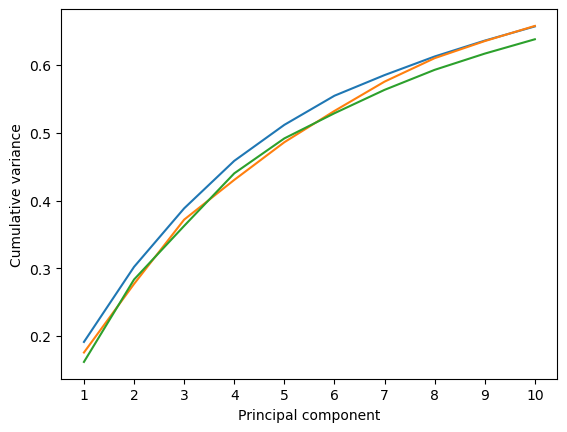

In [16]:
pca_wt_str, var_wt_str= pca_general(wt_str_merged_univ, select="protein and name CA and resid 1-116", n_components= None, frames= None)
pca_wt_str_atp, var_wt_str_atp= pca_general(wt_str_atp_merged_univ, select="protein and name CA and resid 1-116", n_components= None, frames= None)
pca_wt_str_atp_out, var_wt_str_atp_out= pca_general(wt_str_atp_out_merged_univ, select="protein and name CA and resid 1-116", n_components= None, frames= None)

In [17]:
print (pca_wt_str.rmsip(pca_wt_str_atp,n_components=10))
print (pca_wt_str_atp_out.rmsip(pca_wt_str_atp,n_components=10))
print (pca_wt_str.rmsip(pca_wt_str_atp_out,n_components=10))

0.529193722195201
0.790121994075672
0.5094453189523094


### Pocket Metrics

In [69]:
columns_to_plot=[
    "pock_volume",
    "pock_asa",
    "pock_pol_asa",
    "pock_apol_asa",
    "pock_asa22",
    "pock_pol_asa22",
    "pock_apol_asa22",
    "nb_AS",
    "mean_as_ray",
    "mean_as_solv_acc",
    "apol_as_prop",
    "mean_loc_hyd_dens",
    "hydrophobicity_score",
    "volume_score",
    "polarity_score",
    "charge_score",
    "prop_polar_atm",
    "as_density",
    "as_max_dst",
    "convex_hull_volume",
    "nb_abpa"
]


# Output directory
outdir = "/home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/cavity/mdpocket"

Advanced features
- pock_vol : volume of the pocket
- nb_AS : number of alpha spheres
- mean_as_ray : mean alpha sphere radius
- mean_as_solv_acc : mean alpha sphere solvent accessibility
- apol_as_prop : proportion of apolar alpha spheres in the pocket
- mean_loc_hyd_dens : mean local hydrophobic density
- hidrophobicity_score: residue based hydrophobicity scale published by Monera & al. in
the Journal of Protein Science 1, 319329 (1995). For all residues implicated in the binding site the
mean hydrophobicity score is calculated and is used as descriptor for the whole pocket. Each
residue is evaluated only once
- volume_score: similarly to other descriptors, this one is based on data published on (http://www.info.univangers.fr/~gh/Idas/proprietes.htm). This data resumes relative volume of different amino acids. In
order to calculate this descriptor the mean volume score of all amino acids in contact with at least
one alpha sphere of the pocket is calculated. Each residue is evaluated only once.
- polarity score :  hydrophilicity character of a binding pocket. To each residue of the binding pocket a polarity score is assigned (as published on http://www.info.univangers.fr/~gh/Idas/proprietes.htm ). The final polarity score is the mean of all polarity scores of all residues in the binding pocket
- charge score: According to (http://www.info.univangers.fr/~gh/Idas/proprietes.htm ) the charge of each amino
acid in the binding site is tracked. The mean charge for all amino acids in contact with at least one
alpha sphere of the pocket is calculated to form this charge score. Each residue is evaluated only
once.
- prop_polar_atm : proportion of polar atoms
- as_density : alpha sphere density
- as_max_dst : maximum distance between the center of mass and all alpha spheres
- pock_asa : solvent accessible surface area of the pocket
- pock_pol_asa : polar solvent accessible surface area of the pocket
- pock_apol_asa : apolar solvent accessible surface area of the pocket
- pock_asa22 : accessible surface area using a probe of 2.2 A instead of 1.4
- pock_pol_asa22 : see pock_pol_asa and pock_asa22
- pock_apol_asa22 : see pocket_apol_asa and p

Pocket 1

/tmp/ipykernel_610354/3625865092.py:38: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(filepath, delim_whitespace=True, header=0)


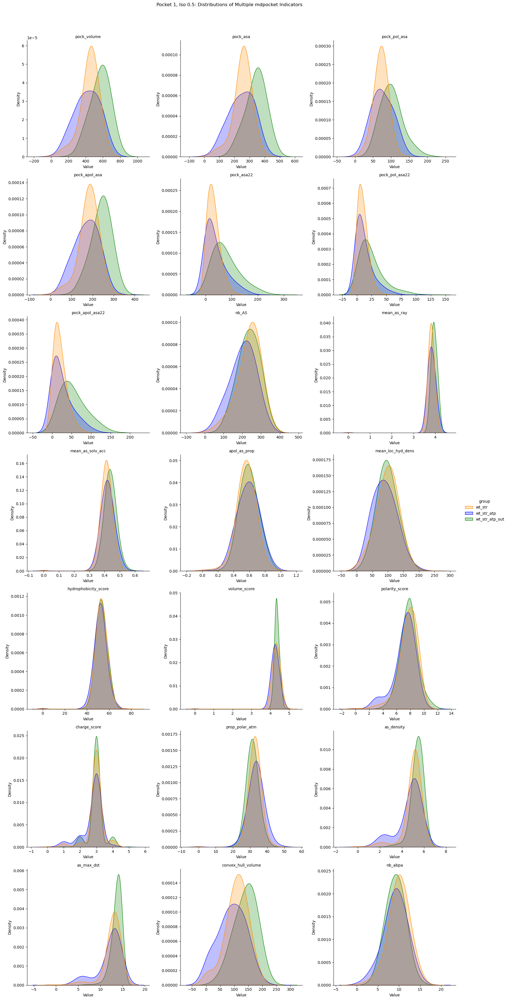

In [ ]:
fin = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_supermerg_pocket/pocket_1_05_descriptors.txt"

plot_mdpocklet_multiple_metrics(filepath=fin,
                            group_list=groups,
                            columns_to_plot=columns_to_plot,
                            pocket_name="Pocket 1, Iso 0.5",
                            bandwidth=0.5,
                            col_wrap=3,
                            save_plots=True,
                            outdir=outdir)

/tmp/ipykernel_610354/3625865092.py:38: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(filepath, delim_whitespace=True, header=0)


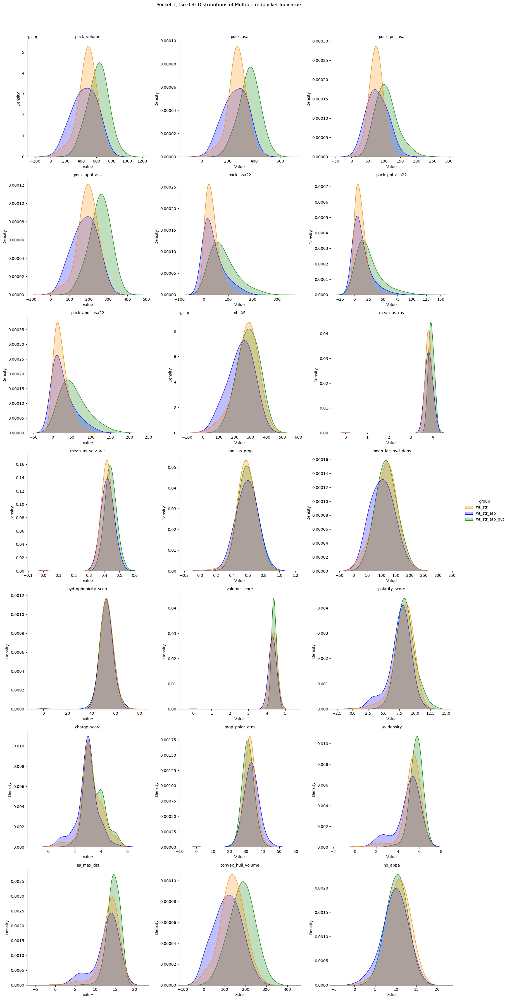

In [71]:
fin = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_supermerg_pocket/pocket_1_04_descriptors.txt"

# Call the plotting function
plot_mdpocklet_multiple_metrics(filepath=fin,
                            group_list=groups,
                            columns_to_plot=columns_to_plot,
                            pocket_name="Pocket 1, Iso 0.4",
                            bandwidth=0.5,
                            col_wrap=3,
                            save_plots=True,
                            outdir=outdir)

/tmp/ipykernel_610354/3625865092.py:38: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(filepath, delim_whitespace=True, header=0)


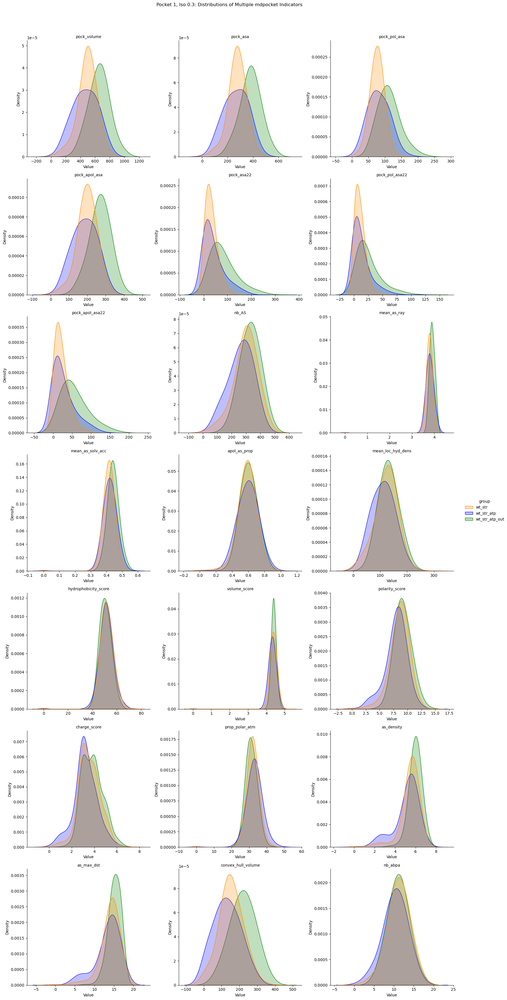

In [72]:
fin = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_supermerg_pocket/pocket_1_03_descriptors.txt"

plot_mdpocklet_multiple_metrics(filepath=fin,
                            group_list=groups,
                            columns_to_plot=columns_to_plot,
                            pocket_name="Pocket 1, Iso 0.3",
                            bandwidth=0.5,
                            col_wrap=3,
                            save_plots=True,
                            outdir=outdir)

Pocket 2

/tmp/ipykernel_610354/3625865092.py:38: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(filepath, delim_whitespace=True, header=0)


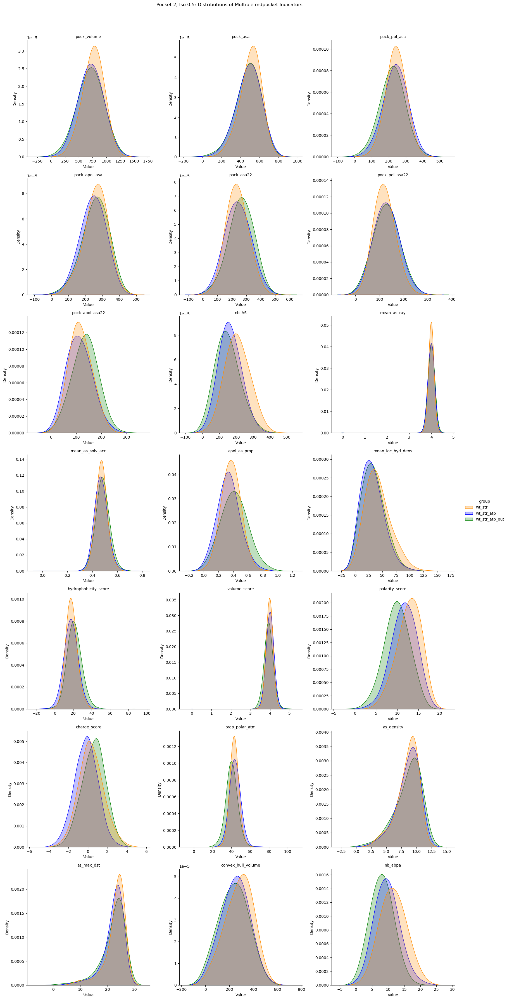

In [73]:
fin = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_supermerg_pocket/pocket_2_05_descriptors.txt"

# Call the plotting function
plot_mdpocklet_multiple_metrics(filepath=fin,
                            group_list=groups,
                            columns_to_plot=columns_to_plot,
                            pocket_name="Pocket 2, Iso 0.5",
                            bandwidth=0.5,
                            col_wrap=3,
                            save_plots=True,
                            outdir=outdir)

/tmp/ipykernel_610354/3625865092.py:38: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(filepath, delim_whitespace=True, header=0)


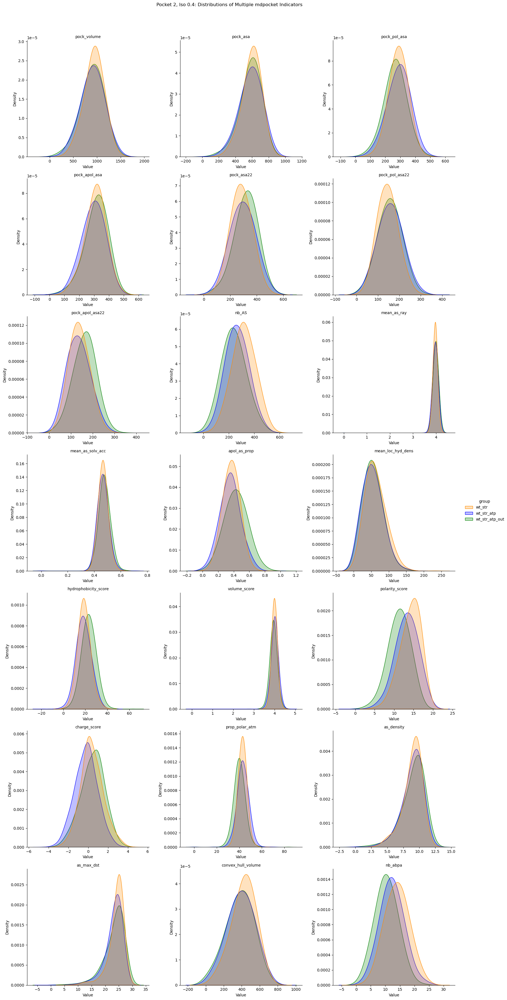

In [74]:
# Suppose you have a file with your data (like you do with "pocket_2_04_descriptors.txt")
fin = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_supermerg_pocket/pocket_2_04_descriptors.txt"

# Call the plotting function
plot_mdpocklet_multiple_metrics(filepath=fin,
                            group_list=groups,
                            columns_to_plot=columns_to_plot,
                            pocket_name="Pocket 2, Iso 0.4",
                            bandwidth=0.5,
                            col_wrap=3,
                            save_plots=True,
                            outdir=outdir)

/tmp/ipykernel_610354/3625865092.py:38: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(filepath, delim_whitespace=True, header=0)


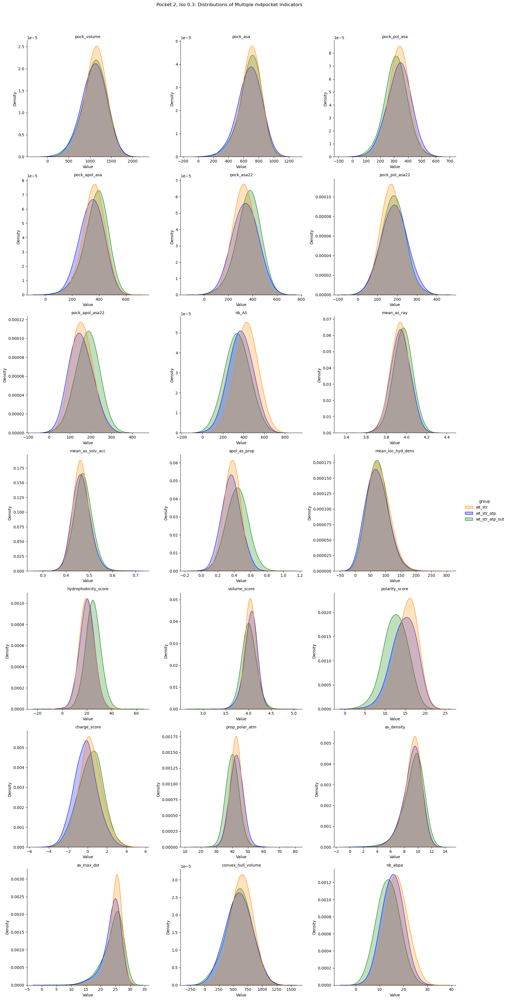

In [75]:
# Suppose you have a file with your data (like you do with "pocket_2_04_descriptors.txt")
fin = "/home/fede/lab/projects/leuko/data/5LOX/wt_str/MD/wt_supermerg_pocket/pocket_2_03_descriptors.txt"

# Call the plotting function
plot_mdpocklet_multiple_metrics(filepath=fin,
                            group_list=groups,
                            columns_to_plot=columns_to_plot,
                            pocket_name="Pocket 2, Iso 0.3",
                            bandwidth=0.5,
                            col_wrap=3,
                            save_plots=True,
                            outdir=outdir)

### Salt bridges

In [7]:
u=wt_str_prot_univs[0]

sel_basic = "(resname ARG LYS) and (name NH* NZ)"
sel_acidic = "(resname ASP GLU) and (name OE* OD*)"
acidic = u.select_atoms(sel_acidic)
basic = u.select_atoms(sel_basic)

def contacts_within_cutoff(u, group_a, group_b, radius=4.5):
    timeseries = []
    for ts in u.trajectory:
        # calculate distances between group_a and group_b
        dist = contacts.distance_array(group_a.positions, group_b.positions)
        # determine which distances <= radius
        n_contacts = contacts.contact_matrix(dist, radius).sum()
        timeseries.append([ts.frame, n_contacts])
    return np.array(timeseries)

ca = contacts_within_cutoff(u, acidic, basic, radius=4.5)

In [23]:
import numpy as np
import pandas as pd
import MDAnalysis.analysis.contacts as contacts

u = wt_str_prot_univs[0]

sel_basic = "(resname ARG LYS) and (name NH* NZ)"
sel_acidic = "(resname ASP GLU) and (name OE* OD*)"
acidic = u.select_atoms(sel_acidic)
basic = u.select_atoms(sel_basic)

def unique_interacting_residues_df(universe, group_a, group_b, radius=4.5):
    """
    Iterates over the trajectory and determines for each frame which residue pairs
    (one from group_a and one from group_b) are in contact (i.e. at least one pair of atoms is
    within the specified radius). Only one entry per residue pair is recorded per frame.

    The output DataFrame is then sorted by frame number and acidic residue number (lowest to highest).

    Returns:
        A pandas DataFrame with columns:
            - Frame
            - Acidic_resname, Acidic_resid
            - Basic_resname, Basic_resid
    """
    rows = []
    
    # Loop over each frame in the trajectory
    for ts in universe.trajectory:
        # Compute the full distance matrix between atoms in group_a and group_b
        dists = contacts.distance_array(group_a.positions, group_b.positions)
        # Build a binary contact matrix (1 if the distance is within the cutoff, 0 otherwise)
        contact_mat = contacts.contact_matrix(dists, radius)
        # Find indices where contacts occur
        indices_a, indices_b = np.where(contact_mat == 1)
        
        # Use a set to store unique residue pairs for this frame
        unique_pairs = set()
        for i, j in zip(indices_a, indices_b):
            # Create a tuple for residue information (resname, resid)
            acidic_res = (group_a[i].resname, group_a[i].resid)
            basic_res = (group_b[j].resname, group_b[j].resid)
            unique_pairs.add((acidic_res, basic_res))
        
        # Append one row per unique residue pair for the current frame
        for (acidic_res, basic_res) in unique_pairs:
            rows.append({
                "Frame": ts.frame,
                "Acidic_resname": acidic_res[0],
                "Acidic_resid": acidic_res[1],
                "Basic_resname": basic_res[0],
                "Basic_resid": basic_res[1]
            })
    
    # Create the DataFrame and sort by 'Frame' and 'Acidic_resid'
    df = pd.DataFrame(rows)
    df = df.sort_values(by=["Frame", "Acidic_resid"]).reset_index(drop=True)
    return df

# Example call:
df_unique_contacts = unique_interacting_residues_df(u, acidic, basic, radius=4.5)
print(df_unique_contacts.head())



   Frame Acidic_resname  Acidic_resid Basic_resname  Basic_resid
0      0            ASP            20           LYS           72
1      0            ASP            45           LYS           40
2      0            ASP            52           LYS           40
3      0            GLU            64           ARG          116
4      0            GLU            71           LYS           35


In [ ]:
def salt_bridge_analysis(selection1: str, selection2: str,
                         universes_1: list, groupname_1: str,
                         universes_2: list, groupname_2: str,
                         universes_3: list = None, groupname_3: str = None,
                         cutoff: float = 4.5,
                         bandwidth: float = 0.5,
                         save_plots: bool = False, outdir: str = "outdir"):
    """
    For each group of MDAnalysis.Universe objects, computes the occupancy (fraction of frames)
    of salt bridges (unique acidic-basic residue contacts) per replicate, then aggregates (mean
    and standard deviation) over replicates. Only salt bridges that have occupancy >= 0.2 in 
    at least one group are kept. Finally, an interactive Plotly grouped bar plot is created 
    with error bars, and hover text shows the occupancy values of each replicate.
    
    This updated version ensures that if a salt bridge is present in one replicate but missing 
    in another (i.e. occupancy=0), the missing replicate is recorded as 0 so that the error 
    bars reflect the true variability.
    
    Parameters
    ----------
    selection1 : str
        Atom selection string for group 1 (e.g. acidic selection).
    selection2 : str
        Atom selection string for group 2 (e.g. basic selection).
    universes_1 : list
        List of MDAnalysis.Universe objects for group 1.
    groupname_1 : str
        Label for group 1.
    universes_2 : list
        List of MDAnalysis.Universe objects for group 2.
    groupname_2 : str
        Label for group 2.
    universes_3 : list, optional
        List of MDAnalysis.Universe objects for a third group.
    groupname_3 : str, optional
        Label for group 3.
    cutoff : float, optional
        Distance cutoff (Å) within which a contact is considered (default: 4.5).
    bandwidth : float, optional
        Bandwidth parameter (currently not used for occupancy analysis).
    save_plots : bool, optional
        If True, saves the interactive plot as an HTML file.
    outdir : str, optional
        Output directory for saved plots.
    
    Returns
    -------
    occupancy_all : pandas.DataFrame
        Combined aggregated occupancy statistics (mean and std) for each salt bridge and group.
    pivot_means : pandas.DataFrame
        Pivoted DataFrame of mean occupancy values.
    pivot_std : pandas.DataFrame
        Pivoted DataFrame of standard deviations.
    group1_raw, group2_raw, group3_raw : pandas.DataFrame
        Raw, per-replicate occupancy details for each group.
    interactive_fig : plotly.graph_objs.Figure
        The interactive Plotly figure.
    """
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    import MDAnalysis.analysis.contacts as contacts
    import os

    # -------------------------------------------------------------------------
    # Helper: For one Universe, compute occupancy per salt bridge.
    def calculate_salt_bridge_occupancy(universe, group_a, group_b, cutoff):
        """
        Iterates over the trajectory of `universe` and counts for each unique salt bridge 
        (acidic-basic residue pair) in how many frames it is present.
        
        Returns:
            occupancy_df: DataFrame with columns:
                - Acidic_resname, Acidic_resid, Basic_resname, Basic_resid,
                - Frames_present: count of frames with contact,
                - Occupancy: fraction (Frames_present / total_frames).
            total_frames: number of frames in the trajectory.
        """
        salt_bridge_counts = {}
        total_frames = 0
        
        for ts in universe.trajectory:
            total_frames += 1
            dists = contacts.distance_array(group_a.positions, group_b.positions)
            contact_mat = contacts.contact_matrix(dists, cutoff)
            indices_a, indices_b = np.where(contact_mat == 1)
            
            unique_pairs = set()
            for i, j in zip(indices_a, indices_b):
                acidic_res = (group_a[i].resname, group_a[i].resid)
                basic_res = (group_b[j].resname, group_b[j].resid)
                unique_pairs.add((acidic_res, basic_res))
                
            for pair in unique_pairs:
                salt_bridge_counts[pair] = salt_bridge_counts.get(pair, 0) + 1
        
        rows = []
        for pair, count in salt_bridge_counts.items():
            occ = count / total_frames
            rows.append({
                "Acidic_resname": pair[0][0],
                "Acidic_resid": pair[0][1],
                "Basic_resname": pair[1][0],
                "Basic_resid": pair[1][1],
                "Frames_present": count,
                "Occupancy": occ
            })
        occupancy_df = pd.DataFrame(rows)
        occupancy_df = occupancy_df.sort_values(by="Occupancy", ascending=False).reset_index(drop=True)
        return occupancy_df, total_frames

    def calculate_group_occupancy(universes, sel_acidic, sel_basic, cutoff):

        replicate_occ_list = []
        for i, uni in enumerate(universes):
            group_a = uni.select_atoms(sel_acidic)
            group_b = uni.select_atoms(sel_basic)
            occ_df, tot_frames = calculate_salt_bridge_occupancy(uni, group_a, group_b, cutoff)
            # Create a unique bridge label for each row.
            occ_df['Bridge'] = (occ_df['Acidic_resname'] +
                                occ_df['Acidic_resid'].astype(str) + "-" +
                                occ_df['Basic_resname'] +
                                occ_df['Basic_resid'].astype(str))
            # Set Bridge as the index and keep only the Occupancy column.
            replicate_occ_list.append(occ_df.set_index('Bridge')['Occupancy'])
        
        # Get union of all Bridges across replicates.
        union_bridges = sorted(set().union(*(rep.index for rep in replicate_occ_list)))
        
        # Create a DataFrame with one column per replicate, filling missing values with 0.
        rep_occ_df = pd.DataFrame(index=union_bridges)
        for i, rep in enumerate(replicate_occ_list):
            rep_occ_df[f"rep{i+1}"] = rep.reindex(union_bridges, fill_value=0)
        
        # Compute mean and std for each salt bridge.
        rep_occ_df['mean'] = rep_occ_df.mean(axis=1)
        # Compute standard deviation using all replicate columns (exclude 'mean' column)
        rep_occ_df['std'] = rep_occ_df.iloc[:, :len(universes)].std(axis=1)
        
        final_stats = rep_occ_df.reset_index().rename(columns={'index': 'Bridge'})
        return final_stats, rep_occ_df

    # -------------------------------------------------------------------------
    # Process
    group1_stats, group1_raw = calculate_group_occupancy(universes_1, selection1, selection2, cutoff)
    group1_stats['Group'] = groupname_1

    group2_stats, group2_raw = calculate_group_occupancy(universes_2, selection1, selection2, cutoff)
    group2_stats['Group'] = groupname_2

    if universes_3 and groupname_3:
        group3_stats, group3_raw = calculate_group_occupancy(universes_3, selection1, selection2, cutoff)
        group3_stats['Group'] = groupname_3
    else:
        group3_stats, group3_raw = None, None

    # Combine group statistics.
    if group3_stats is not None:
        occupancy_all = pd.concat([group1_stats, group2_stats, group3_stats], ignore_index=True)
    else:
        occupancy_all = pd.concat([group1_stats, group2_stats], ignore_index=True)

    # -------------------------------------------------------------------------
    # Filter: Keep only salt bridges that have mean occupancy >= 0.2 in at least one group.
    bridges_to_keep = (occupancy_all.groupby('Bridge')['mean']
                       .max()
                       .reset_index()
                       .query("mean >= 0.2")['Bridge'].tolist())
    occupancy_all = occupancy_all[occupancy_all['Bridge'].isin(bridges_to_keep)]

    # Pivot the data for means and std, with groups as columns.
    pivot_means = occupancy_all.pivot(index='Bridge', columns='Group', values='mean').fillna(0)
    pivot_std   = occupancy_all.pivot(index='Bridge', columns='Group', values='std').fillna(0)

    # -------------------------------------------------------------------------
    # Prepare replicate-level details for hover info.
    def get_replicate_details(raw_df, bridges):
        details = []
        for bridge in bridges:
            if bridge in raw_df.index:
                # Get replicate columns by dropping the aggregated columns.
                rep_values = raw_df.loc[bridge].drop(labels=['mean', 'std'], errors='ignore')
                details.append(", ".join(f"{v:.2f}" for v in rep_values))
            else:
                details.append("N/A")
        return details


    bridges = pivot_means.index.tolist()
.
    rep_details_1 = get_replicate_details(group1_raw, bridges)
    rep_details_2 = get_replicate_details(group2_raw, bridges)
    if group3_raw is not None:
        rep_details_3 = get_replicate_details(group3_raw, bridges)
    else:
        rep_details_3 = None

    # -------------------------------------------------------------------------
    # Create an interactive Plotly grouped bar plot with error bars.
    import plotly.graph_objects as go
    fig = go.Figure()
    x = bridges
    if groupname_1 in pivot_means.columns:
        fig.add_trace(go.Bar(
            x=x,
            y=pivot_means[groupname_1].values,
            name=groupname_1,
            error_y=dict(type='data', array=pivot_std[groupname_1].values, symmetric=False),
            customdata=rep_details_1,
            hovertemplate =
              "<b>%{x}</b><br>" +
              groupname_1 + ": %{y:.2f} ± %{error_y.array:.2f}<br>" +
              "Replicates: %{customdata}<extra></extra>"
        ))
    if groupname_2 in pivot_means.columns:
        fig.add_trace(go.Bar(
            x=x,
            y=pivot_means[groupname_2].values,
            name=groupname_2,
            error_y=dict(type='data', array=pivot_std[groupname_2].values, symmetric=False),
            customdata=rep_details_2,
            hovertemplate =
              "<b>%{x}</b><br>" +
              groupname_2 + ": %{y:.2f} ± %{error_y.array:.2f}<br>" +
              "Replicates: %{customdata}<extra></extra>"
        ))
    if rep_details_3 is not None and groupname_3 in pivot_means.columns:
        fig.add_trace(go.Bar(
            x=x,
            y=pivot_means[groupname_3].values,
            name=groupname_3,
            error_y=dict(type='data', array=pivot_std[groupname_3].values, symmetric=False),
            customdata=rep_details_3,
            hovertemplate =
              "<b>%{x}</b><br>" +
              groupname_3 + ": %{y:.2f} ± %{error_y.array:.2f}<br>" +
              "Replicates: %{customdata}<extra></extra>"
        ))

    fig.update_layout(
        barmode='group',
        xaxis_title="Salt Bridge",
        yaxis_title="Mean Occupancy (Fraction of Frames)",
        title="Salt Bridge Occupancy Comparison Across Groups (Bridges with occupancy ≥ 0.2)",
        xaxis_tickangle=-45
    )
    fig.show()
    if save_plots:
        if not os.path.isdir(outdir):
            os.makedirs(outdir)
        fig.write_html(os.path.join(outdir, "interactive_group_salt_bridge_occupancy.html"))

    return occupancy_all, pivot_means, pivot_std, group1_raw, group2_raw, group3_raw, fig



In [ ]:
occupancy_all, pivot_means, pivot_std, wt_raw, mut_raw, other_raw, interactive_fig  = salt_bridge_analysis(sel_acidic, sel_basic,
              wt_str_prot_univs, "ATP-",
              wt_str_atp_prot_univs, "ATP+",
              wt_str_atp_out_prot_univs, "ATP+ out",
              cutoff=4.5,
              save_plots=True,
              outdir=outdir
              )

In [ ]:
def salt_bridge_quantitative(selection1: str, selection2: str,
                         universes_1: list, groupname_1: str,
                         universes_2: list, groupname_2: str,
                         universes_3: list = None, groupname_3: str = None,
                         cutoff: float = 4.5,
                         bandwidth: float = 0.5,
                         save_plots: bool = False, outdir: str = "outdir"):
    """
    Plots the salt bridge analysis (i.e., the number of contacts between two atom selections)
    over the trajectory for each of the universes in up to three groups. For each frame, 
    the number of contacts is determined by computing the pairwise distances between the atoms in 
    the two selections and summing the number of pairs that fall below a specified cutoff (default 4.5 Å).

    Replicate-level time series are plotted as individual lines, and full contact distributions 
    (all frames combined) are shown as KDE plots for each group.

    Parameters
    ----------
    selection1 : str
        Atom selection string for group 1 (e.g., acidic residues).
    selection2 : str
        Atom selection string for group 2 (e.g., basic residues).
    universes_1 : list
        List of MDAnalysis.Universe objects for the first group.
    groupname_1 : str
        Name of the first group (used in labeling).
    universes_2 : list
        List of MDAnalysis.Universe objects for the second group.
    groupname_2 : str
        Name of the second group (used in labeling).
    universes_3 : list, optional
        List of MDAnalysis.Universe objects for a third group (if provided).
    groupname_3 : str, optional
        Name of the third group (used in labeling if provided).
    cutoff : float, optional
        Distance cutoff (in Å) within which contacts are considered (default is 4.5).
    bandwidth : float, optional
        Bandwidth parameter for the KDE plot.
    save_plots : bool, optional
        If True, plots will be saved to the specified outdir.
    outdir : str, optional
        Directory where plots should be saved.
    """

    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns
    import MDAnalysis.analysis.contacts as contacts  # assuming the contacts module is available
    import os

    def calculate_contacts(universe, sel1, sel2, cutoff):
        group1 = universe.select_atoms(sel1)
        group2 = universe.select_atoms(sel2)
        contact_timeseries = []
    
        for ts in universe.trajectory:
            # Compute the pairwise distance matrix
            dists = contacts.distance_array(group1.positions, group2.positions)
            # UContact matrix to mark distances below the cutoff and sum up the contacts
            n_contacts = contacts.contact_matrix(dists, cutoff).sum()
            contact_timeseries.append(n_contacts)
        return contact_timeseries

    
    plt.figure(figsize=(18, 6))
    colors = ['orangered', 'darkorange', 'coral', 'b', 'navy', 'deepskyblue',
              'darkgreen', 'lime', 'mediumseagreen']

    # Lists to store *all* contact counts across frames for full-distribution (for KDE)
    contacts_1, contacts_2, contacts_3 = [], [], []
    # Lists to store replicate-level summary (mean contacts per replicate)
    replicate_means_1, replicate_means_2, replicate_means_3 = [], [], []

    # Group 1 processing

    for i, universe in enumerate(universes_1):
        cts = calculate_contacts(universe, selection1, selection2, cutoff)
        contacts_1.extend(cts)
        replicate_means_1.append(np.mean(cts))
        plt.plot(cts, label=f'{groupname_1} r{i+1}', c=colors[i], linewidth=0.7)

    # Group 2 processing

    offset = len(universes_1)  # offset to use different colors for the next group
    for i, universe in enumerate(universes_2):
        cts = calculate_contacts(universe, selection1, selection2, cutoff)
        contacts_2.extend(cts)
        replicate_means_2.append(np.mean(cts))
        plt.plot(cts, label=f'{groupname_2} r{i+1}', c=colors[offset + i], linewidth=0.7)


    # Group 3 processing (if provided)

    if universes_3 and groupname_3:
        offset += len(universes_2)
        for i, universe in enumerate(universes_3):
            cts = calculate_contacts(universe, selection1, selection2, cutoff)
            contacts_3.extend(cts)
            replicate_means_3.append(np.mean(cts))
            plt.plot(cts, label=f'{groupname_3} r{i+1}', c=colors[offset + i], linewidth=0.7)

    plt.title(f'Salt Bridge Analysis: Contacts between\n{selection1} and {selection2} over trajectory')
    plt.xlabel('Frame')
    plt.ylabel('# Salt Bridges')
    plt.legend()
    plt.grid(False)
    plt.tight_layout()

    # Save plot if requested
    groupnames = f"{groupname_1}_{groupname_2}_{groupname_3}" if groupname_3 else f"{groupname_1}_{groupname_2}"
    if save_plots:
        if not os.path.isdir(outdir):
            os.makedirs(outdir)
        fout = os.path.join(outdir, f'salt_bridge_{groupnames}.png')
        plt.savefig(fout, dpi=300, facecolor='white', bbox_inches='tight')
    plt.show()

    # KDE Plot of the full distributions
    plt.figure(figsize=(6, 4))
    sns.kdeplot(contacts_1, fill=True, color="darkorange", bw_method=bandwidth, label=groupname_1)
    sns.kdeplot(contacts_2, fill=True, color="b", bw_method=bandwidth, label=groupname_2)
    if contacts_3:  # Only plot Group 3 if provided
        sns.kdeplot(contacts_3, fill=True, color="green", bw_method=bandwidth, label=groupname_3)

    plt.xlabel('# Salt Bridges')
    plt.ylabel('Density')
    plt.title(f'Distribution of salt bridge counts\nbetween {selection1} and {selection2}')
    plt.legend()
    if save_plots:
        fout_kde = os.path.join(outdir, f'kde_salt_bridge_{groupnames}.png')
        plt.savefig(fout_kde, dpi=300, facecolor='white', bbox_inches='tight')
    plt.show()


salt bridge 505- 132 drops with atp??
also 623-102?
173- 172 skyrockets with atp??


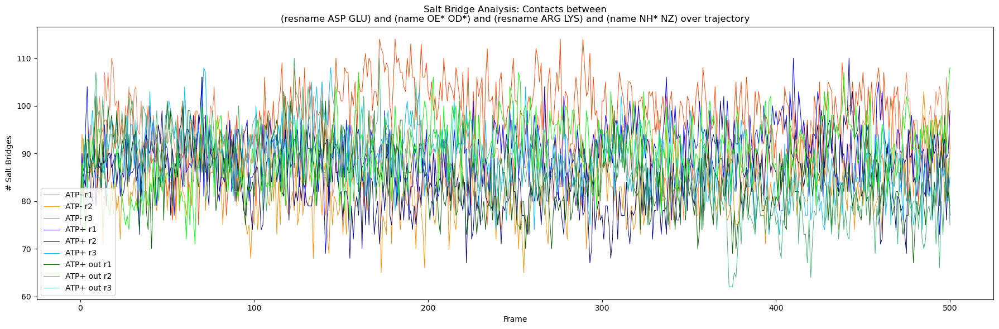

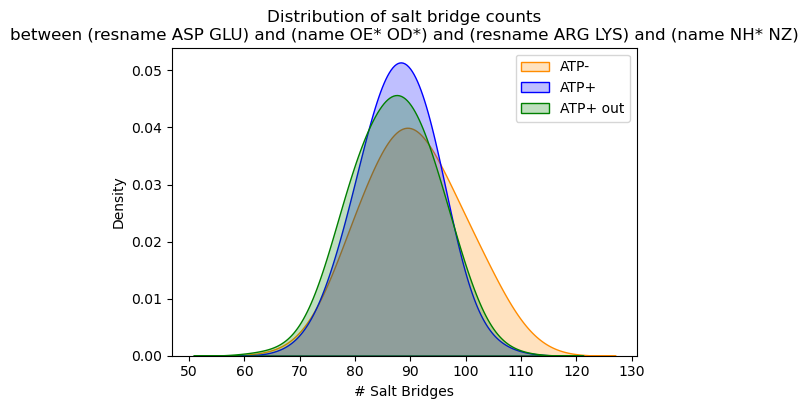

In [ ]:
salt_bridge_quantitative(sel_acidic, sel_basic,
              wt_str_prot_univs, "ATP-",
              wt_str_atp_prot_univs, "ATP+",
              wt_str_atp_out_prot_univs, "ATP+ out",
              cutoff=4.5,
              save_plots=False,
              outdir=outdir
              )

## Ile-only state free energy plot
1-D PMF for CV-1: distance between the Fe atom and the joint centre-of-mass of the pocket four residues (heavy atoms only).


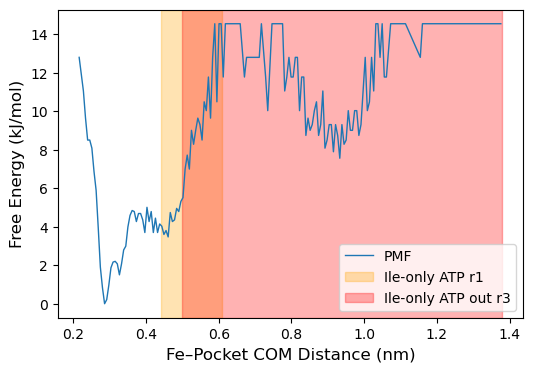

In [ ]:
# Load PMF data (distance vs free energy) from gromacs-computed XVG file
distances = []
energies = []
with open('/home/fede/lab/projects/leuko/analyses/5LOX/MD/wt_str/500/free_energy_coordination/pmf_dist.xvg', 'r') as f:
    for line in f:
        if line.startswith(('#', '@')):
            continue
        parts = line.split()
        if len(parts) < 2:
            continue
        distances.append(float(parts[0]))
        energies.append(float(parts[1]))

distances = np.array(distances)
energies  = np.array(energies)

# Define highlight regions (physical distance ranges in nm)
region1_lo, region1_hi = 0.44037, 0.60944  # Ile-only cluster interval 1
region2_lo, region2_hi = 0.49867, 1.37900  # Ile-only cluster interval 2

fig, ax = plt.subplots(figsize=(6,4))
ax.plot(distances, energies, lw=1, label='PMF')


ax.axvspan(region1_lo, region1_hi, color='orange', alpha=0.3, label='Ile-only ATP r1')
ax.axvspan(region2_lo, region2_hi, color='red',    alpha=0.3, label='Ile-only ATP out r3')

ax.set_xlabel('Fe–Pocket COM Distance (nm)', fontsize=12)
ax.set_ylabel('Free Energy (kJ/mol)', fontsize=12)
ax.legend()

## 